In [188]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import time
import graphviz
import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.multioutput import MultiOutputClassifier
from sklearn.model_selection import KFold
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate, train_test_split, RandomizedSearchCV
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score
from xgboost import XGBClassifier
from sklearn.linear_model import LogisticRegressionCV
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.preprocessing import FunctionTransformer


In [189]:
#Reading data
df = pd.read_csv('Project2Data.csv')
df_postcode = pd.read_csv('PostcodeData.csv')

df

,CustomerID,Has_Transaction_Nov23_May24,Total_Spent_1M,Transaction_Count_1M,Total_Spent_3M,Transaction_Count_3M,Total_Spent_6M,Transaction_Count_6M,Total_Spent_9M,Transaction_Count_9M,...,EAN_Pure10NiacinamideSerum,EAN_CicaplastB5BaumeBothSKUs40ml,Post Code,Brand Description_Anthelios_Output,Brand Description_Cicaplast_Output,Brand Description_Effaclar_Output,Brand Description_Hyalu B5_Output,Brand Description_Lipikar_Output,Brand Description_Toleriane_Output,Brand Description_Vitamin C_Output
0,LRP00002,1,143.00,1,143.00,1,143.00,1,143.00,1,...,0,0,NaN,0,0,1,0,1,1,1
1,LRP00004,1,0.00,0,0.00,0,189.36,1,189.36,1,...,0,0,NaN,0,1,1,1,1,1,1
2,LRP00008,1,0.00,0,0.00,0,161.59,1,161.59,1,...,0,1,NaN,1,0,1,0,0,0,0
3,LRP00009,1,73.62,1,73.62,1,73.62,1,73.62,1,...,0,0,NaN,1,1,0,0,1,0,0
4,LRP00012,1,0.00,0,0.00,0,0.00,0,0.00,0,...,0,0,NaN,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6395,LRP53766,1,0.00,0,133.85,1,133.85,1,133.85,1,...,0,0,NaN,0,0,0,0,0,0,0
6396,LRP53769,1,100.15,1,100.15,1,100.15,1,100.15,1,...,0,0,NaN,0,0,1,0,0,0,0
6397,LRP53780,1,0.00,0,180.67,1,180.67,1,180.67,1,...,0,0,NaN,0,0,1,0,0,0,0
6398,LRP53805,1,63.40,1,63.40,1,63.40,1,63.40,1,...,0,0,NaN,0,1,0,0,0,1,0


In [190]:
print ('Shape of the given dataset is {}.Contains {} rows and {} columns '.format(df.shape,df.shape[0],df.shape[1]))

Shape of the given dataset is (6400, 68).Contains 6400 rows and 68 columns 


# 1. Understanding and Cleaning data

In [191]:
df.duplicated().sum()

0

In [192]:
#Remove 2 unnecessary columns
df = df.drop(['CustomerID', 'Has_Transaction_Nov23_May24'], axis=1)

In [193]:
df.columns

Index(['Total_Spent_1M', 'Transaction_Count_1M', 'Total_Spent_3M',
       'Transaction_Count_3M', 'Total_Spent_6M', 'Transaction_Count_6M',
       'Total_Spent_9M', 'Transaction_Count_9M', 'Total_Spent_12M',
       'Transaction_Count_12M', 'Total_Spent_AllTime',
       'Transaction_Count_AllTime', 'Brand Description_Anthelios',
       'Brand Description_Bundle', 'Brand Description_Cicaplast',
       'Brand Description_Eau Thermale', 'Brand Description_Effaclar',
       'Brand Description_Hyalu B5', 'Brand Description_Lipikar',
       'Brand Description_Niacinamide', 'Brand Description_Retinol LRP',
       'Brand Description_Serozinc', 'Brand Description_Toleriane',
       'Brand Description_Uvidea', 'Brand Description_Vitamin C',
       'Class Description_Anti-Acne', 'Class Description_Anti-Ageing',
       'Class Description_Body Care', 'Class Description_Bundle',
       'Class Description_Face Care', 'Category_Body Care',
       'Category_Face Care', 'Category_Face Care ', 'Category_S

In [194]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6400 entries, 0 to 6399
Data columns (total 66 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Total_Spent_1M                            6400 non-null   float64
 1   Transaction_Count_1M                      6400 non-null   int64  
 2   Total_Spent_3M                            6400 non-null   float64
 3   Transaction_Count_3M                      6400 non-null   int64  
 4   Total_Spent_6M                            6400 non-null   float64
 5   Transaction_Count_6M                      6400 non-null   int64  
 6   Total_Spent_9M                            6400 non-null   float64
 7   Transaction_Count_9M                      6400 non-null   int64  
 8   Total_Spent_12M                           6400 non-null   float64
 9   Transaction_Count_12M                     6400 non-null   int64  
 10  Total_Spent_AllTime                 

In [195]:
# Sum up 2 columns Category_FaceCare into 1
df['Category_Face Care'] = df['Category_Face Care'] + df['Category_Face Care ']
df = df.drop(columns=['Category_Face Care '])

In [196]:
#Remove blank space in columns' names
df.columns = df.columns.str.replace(' ', '')

In [197]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6400 entries, 0 to 6399
Data columns (total 65 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Total_Spent_1M                        6400 non-null   float64
 1   Transaction_Count_1M                  6400 non-null   int64  
 2   Total_Spent_3M                        6400 non-null   float64
 3   Transaction_Count_3M                  6400 non-null   int64  
 4   Total_Spent_6M                        6400 non-null   float64
 5   Transaction_Count_6M                  6400 non-null   int64  
 6   Total_Spent_9M                        6400 non-null   float64
 7   Transaction_Count_9M                  6400 non-null   int64  
 8   Total_Spent_12M                       6400 non-null   float64
 9   Transaction_Count_12M                 6400 non-null   int64  
 10  Total_Spent_AllTime                   6400 non-null   float64
 11  Transaction_Count

In [198]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Total_Spent_1M,6400.0,34.455266,69.569793,0.0,0.0,0.00,53.96,872.74
Transaction_Count_1M,6400.0,0.292812,0.518040,0.0,0.0,0.00,1.00,6.00
Total_Spent_3M,6400.0,62.449945,94.729159,0.0,0.0,0.00,107.85,960.93
Transaction_Count_3M,6400.0,0.541562,0.724943,0.0,0.0,0.00,1.00,9.00
Total_Spent_6M,6400.0,114.505731,135.895771,0.0,0.0,84.72,161.85,1875.75
...,...,...,...,...,...,...,...,...
BrandDescription_Effaclar_Output,6400.0,0.414687,0.492707,0.0,0.0,0.00,1.00,1.00
BrandDescription_HyaluB5_Output,6400.0,0.087344,0.282360,0.0,0.0,0.00,0.00,1.00
BrandDescription_Lipikar_Output,6400.0,0.214219,0.410311,0.0,0.0,0.00,0.00,1.00
BrandDescription_Toleriane_Output,6400.0,0.390000,0.487788,0.0,0.0,0.00,1.00,1.00


In [199]:
#Missing values
df['PostCode'].isnull().sum()

5326

In [200]:
df.shape

(6400, 65)

# 1.1. Encoding target variable

In [201]:
binary_col = df.columns[df.columns.str.contains("Output")]

for i in binary_col:
    unique_values = df[i].astype('int64').unique()
    print(i, ":", unique_values)

BrandDescription_Anthelios_Output : [0 1]
BrandDescription_Cicaplast_Output : [0 1]
BrandDescription_Effaclar_Output : [1 0]
BrandDescription_HyaluB5_Output : [0 1]
BrandDescription_Lipikar_Output : [1 0]
BrandDescription_Toleriane_Output : [1 0]
BrandDescription_VitaminC_Output : [1 0]


In [202]:
# converting to binary data, cause columns are already binary, there’s no need to use pd.get_dummies()
binary_target =df[binary_col].astype('int64')
print(binary_target)

      BrandDescription_Anthelios_Output  BrandDescription_Cicaplast_Output  \
0                                     0                                  0   
1                                     0                                  1   
2                                     1                                  0   
3                                     1                                  1   
4                                     0                                  0   
...                                 ...                                ...   
6395                                  0                                  0   
6396                                  0                                  0   
6397                                  0                                  0   
6398                                  0                                  1   
6399                                  0                                  0   

      BrandDescription_Effaclar_Output  BrandDescription_HyaluB

# 1.2. Handling outliers

In [203]:
#This is the function with threhold of 80% that we will use
def remove_outliers(df, columns):
    original_shape = df.shape

    indices_to_remove = []
    for column in columns:
        data = df[column]
        Q1 = data.quantile(0.25)
        Q3 = data.quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 3 * IQR
        upper_bound = Q3 + 3 * IQR
        outliers = df[(data < lower_bound) | (data > upper_bound)]
        unique_outliers = outliers[column].unique()
        outliers_index = outliers.index
        if len(unique_outliers) < 0.8 * (len(data.unique())):
            indices_to_remove.extend(outliers_index)

    indices_to_remove = list(set(indices_to_remove))
    df_clean = df.drop(index=indices_to_remove)

    new_shape = df_clean.shape

    rows_removed = original_shape[0] - new_shape[0]
    print(f"Original shape: {original_shape}")
    print(f"New shape after outlier removal: {new_shape}")
    print(f"Number of rows removed: {rows_removed}")

    return df_clean

In [204]:
#Function to plot box plot for removed outliers
def plot_outliers(df, columns, plot_title=None):
    df_long = df.melt(value_vars=columns, var_name='Category', value_name='Value')

    fig = px.box(df_long, x='Category', y='Value',
                 title=plot_title,
                 labels={'Value': 'Value', 'Variable': 'Variable'},
                 template='plotly_white')

    fig.update_xaxes(tickangle=45)

    fig.update_layout(height=600, width=1000, boxmode='group')

    fig.show()

In [205]:
skin_concern_columns = df.columns[df.columns.str.contains("SkinConcern")]
brand_description_columns = df.columns[df.columns.str.contains("BrandDescription") & ~df.columns.str.endswith("Output")]
sub_category_columns = df.columns[df.columns.str.contains("Sub-Category")]
EAN_columns = df.columns[df.columns.str.contains("EAN")]
transaction_count_columns = df.columns[df.columns.str.contains("Transaction")]
total_spent_columns = df.columns[df.columns.str.contains("Total_Spent")]


In [206]:
# df_clean_skin_concern = remove_outliers(df, skin_concern_columns)
# plot_outliers(df_clean_skin_concern, skin_concern_columns, plot_title='Boxplot for Skin Concerns (Outliers Removed)')

# df_clean_brand_description = remove_outliers(df, brand_description_columns)
# plot_outliers(df_clean_brand_description, brand_description_columns, plot_title='Boxplot for Brand Descriptions (Outliers Removed)')

# df_clean_sub_category = remove_outliers(df, sub_category_columns)
# plot_outliers(df_clean_sub_category, sub_category_columns, plot_title='Boxplot for Sub-Category (Outliers Removed)')

# df_clean_EAN = remove_outliers(df, EAN_columns)
# plot_outliers(df_clean_EAN, EAN_columns, plot_title='Boxplot for Individual Products (Outliers Removed)')

df_clean_transaction = remove_outliers(df, transaction_count_columns)
plot_outliers(df_clean_transaction, transaction_count_columns, plot_title='Boxplot for Transaction Count (Outliers Removed)')

df_clean_total_spent = remove_outliers(df, total_spent_columns)
plot_outliers(df_clean_total_spent, total_spent_columns, plot_title='Boxplot for Total Spent (Outliers Removed)')


Original shape: (6400, 65)
New shape after outlier removal: (6250, 65)
Number of rows removed: 150


Original shape: (6400, 65)
New shape after outlier removal: (6051, 65)
Number of rows removed: 349


In [207]:
#Remove outliers using normal IQR away, we are not using this cause it cuts a lot of valuable information
# This is just to see the plots and for justification why we are using 80% threshold

def remove_outliers2(df, columns):
    original_shape = df.shape
    df_clean = df.copy()

    indices_to_remove = set()
    for column in columns:
        data = df[column]
        Q1 = data.quantile(0.25)
        Q3 = data.quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 3 * IQR
        upper_bound = Q3 + 3 * IQR
        outliers_index = df[(data < lower_bound) | (data > upper_bound)].index
        indices_to_remove.update(outliers_index)

    df_clean = df_clean.drop(index=indices_to_remove)

    new_shape = df_clean.shape

    rows_removed = original_shape[0] - new_shape[0]
    print(f"Original shape: {original_shape}")
    print(f"New shape after outlier removal: {new_shape}")
    print(f"Number of rows removed: {rows_removed}")

    return df_clean

In [208]:
df_clean_skin_concern = remove_outliers2(df, skin_concern_columns)
plot_outliers(df_clean_skin_concern, skin_concern_columns, plot_title='Boxplot for Skin Concerns (Outliers Removed)')

df_clean_brand_description = remove_outliers2(df, brand_description_columns)
plot_outliers(df_clean_brand_description, brand_description_columns, plot_title='Boxplot for Brand Descriptions (Outliers Removed)')

df_clean_sub_category = remove_outliers2(df, sub_category_columns)
plot_outliers(df_clean_sub_category, sub_category_columns, plot_title='Boxplot for Sub-Category (Outliers Removed)')

df_clean_EAN = remove_outliers2(df, EAN_columns)
plot_outliers(df_clean_EAN, EAN_columns, plot_title='Boxplot for Individual Products (Outliers Removed)')

df_clean_transaction = remove_outliers2(df, transaction_count_columns)
plot_outliers(df_clean_transaction, transaction_count_columns, plot_title='Boxplot for Transaction Count (Outliers Removed)')

df_clean_total_spent = remove_outliers2(df, total_spent_columns)
plot_outliers(df_clean_total_spent, total_spent_columns, plot_title='Boxplot for Total Spent (Outliers Removed)')

Original shape: (6400, 65)
New shape after outlier removal: (5172, 65)
Number of rows removed: 1228


Original shape: (6400, 65)
New shape after outlier removal: (2302, 65)
Number of rows removed: 4098


Original shape: (6400, 65)
New shape after outlier removal: (2539, 65)
Number of rows removed: 3861


Original shape: (6400, 65)
New shape after outlier removal: (2473, 65)
Number of rows removed: 3927


Original shape: (6400, 65)
New shape after outlier removal: (6250, 65)
Number of rows removed: 150


Original shape: (6400, 65)
New shape after outlier removal: (6051, 65)
Number of rows removed: 349


In [209]:
df = remove_outliers(df, ['Total_Spent_12M', 'Transaction_Count_12M'])

Original shape: (6400, 65)
New shape after outlier removal: (6218, 65)
Number of rows removed: 182


In [210]:
relevant_columns = ['Total_Spent_1M', 'Total_Spent_3M', 'Total_Spent_6M', 'Total_Spent_9M', 'Total_Spent_12M', 'Total_Spent_AllTime',
                    'Transaction_Count_1M', 'Transaction_Count_3M', 'Transaction_Count_6M', 'Transaction_Count_9M', 'Transaction_Count_12M',
                    'Transaction_Count_AllTime']

skewness_values = df[relevant_columns].skew()

log_transformed_data = df.copy()
for column in relevant_columns:
    log_transformed_data[column] = np.log1p(log_transformed_data[column])

log_skewness_values = log_transformed_data[relevant_columns].skew()

log_skewness_values


Total_Spent_1M               1.167258
Total_Spent_3M               0.364521
Total_Spent_6M              -0.571558
Total_Spent_9M              -1.271762
Total_Spent_12M             -1.856630
Total_Spent_AllTime          0.245058
Transaction_Count_1M         1.257550
Transaction_Count_3M         0.616700
Transaction_Count_6M         0.036684
Transaction_Count_9M        -0.163011
Transaction_Count_12M       -0.110018
Transaction_Count_AllTime    1.012395
dtype: float64

# 2. Initial EDA

## 2.1. Class imbalance

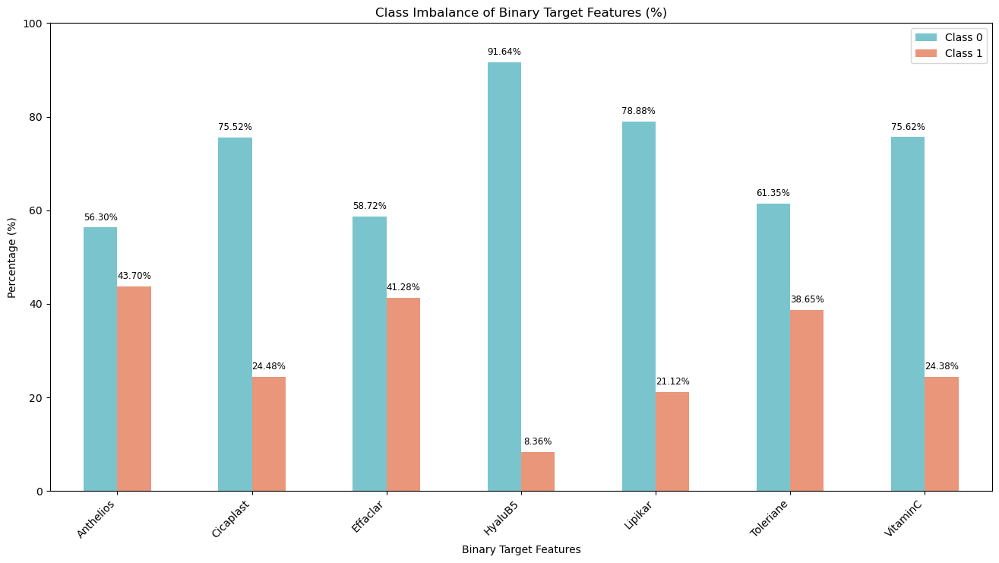

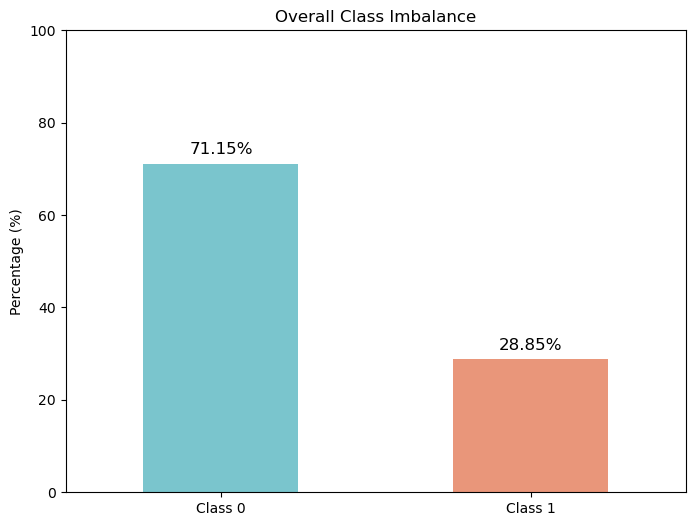

In [211]:
columns_of_interest = [
    'BrandDescription_Anthelios_Output',
    'BrandDescription_Cicaplast_Output',
    'BrandDescription_Effaclar_Output',
    'BrandDescription_HyaluB5_Output',
    'BrandDescription_Lipikar_Output',
    'BrandDescription_Toleriane_Output',
    'BrandDescription_VitaminC_Output'
]

custom_labels = {
    'BrandDescription_Anthelios_Output': 'Anthelios Products',
    'BrandDescription_Cicaplast_Output': 'Cicaplast Products',
    'BrandDescription_Effaclar_Output': 'Effaclar Products',
    'BrandDescription_HyaluB5_Output': 'Hyalu B5 Products',
    'BrandDescription_Lipikar_Output': 'Lipikar Products',
    'BrandDescription_Toleriane_Output': 'Toleriane Products',
    'BrandDescription_VitaminC_Output': 'Vitamin C Products'
}

class_imbalance = pd.DataFrame({
    'Class 0': [(df[col] == 0).mean() * 100 for col in columns_of_interest],
    'Class 1': [(df[col] == 1).mean() * 100 for col in columns_of_interest]
}, index=[col.replace('BrandDescription_', '').replace('_Output', '') for col in columns_of_interest])

class_imbalance = class_imbalance.rename(index=custom_labels)

fig, ax = plt.subplots(figsize=(16, 8))
class_imbalance.plot(kind='bar', stacked=False, ax=ax, color=['#7ac5cd', '#e9967a'])
ax.set_ylabel('Percentage (%)')
ax.set_xlabel('Binary Target Features')
ax.set_title('Class Imbalance of Binary Target Features (%)')
plt.xticks(rotation=45, ha='right')
plt.ylim(0, 100)

for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height:.2f}%',
                xy=(p.get_x() + p.get_width() / 2, height),
                xytext=(0, 5),
                textcoords='offset points',
                ha='center', va='bottom',
                fontsize=8.5)

overall_class_imbalance = pd.Series({
    'Class 0': (df[columns_of_interest] == 0).sum().sum() / (df[columns_of_interest].size) * 100,
    'Class 1': (df[columns_of_interest] == 1).sum().sum() / (df[columns_of_interest].size) * 100
})

fig2, ax2 = plt.subplots(figsize=(8, 6))
overall_class_imbalance.plot(kind='bar', ax=ax2, color=['#7ac5cd', '#e9967a'])
ax2.set_ylabel('Percentage (%)')
ax2.set_title('Overall Class Imbalance')
ax2.set_xticklabels(['Class 0', 'Class 1'], rotation=0)
plt.ylim(0, 100)

# Add annotations
for i, v in enumerate(overall_class_imbalance.values):
    plt.text(i, v + 2, f"{v:.2f}%", ha='center', fontsize=12)

plt.show()


## 2.2. Multivariate analysis

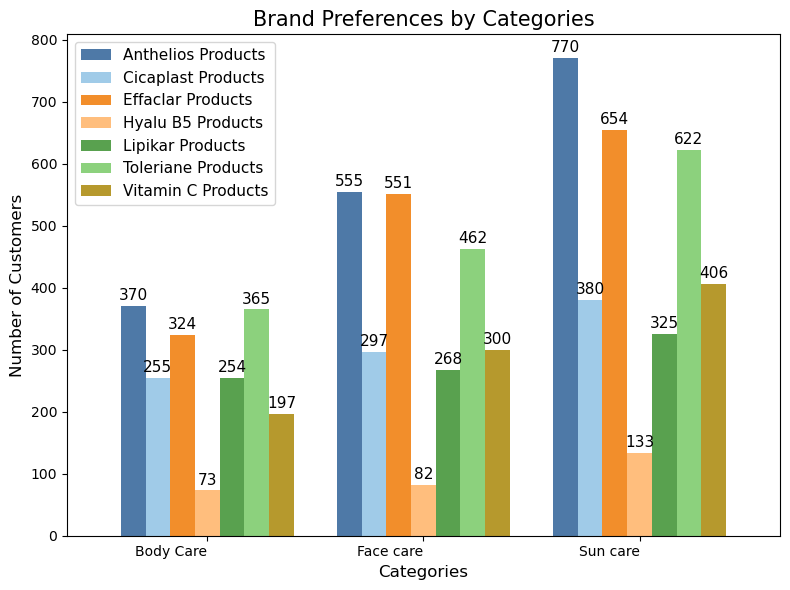

In [212]:
brand_columns = [
    'BrandDescription_Anthelios_Output', 'BrandDescription_Cicaplast_Output',
    'BrandDescription_Effaclar_Output', 'BrandDescription_HyaluB5_Output',
    'BrandDescription_Lipikar_Output', 'BrandDescription_Toleriane_Output',
    'BrandDescription_VitaminC_Output'
]
category_columns = [
    'Category_BodyCare',
    'Category_FaceCare',
    'Category_SunCare',
]

brand_category_summary = pd.DataFrame()

for brand in brand_columns:
    brand_category_summary[brand] = [
        df[df[category] == 1][brand].sum() for category in category_columns
    ]

brand_category_summary.index = ['Body Care', 'Face care', 'Sun care']
colors = ["#4E79A7", "#A0CBE8", "#F28E2B", "#FFBE7D", "#59A14F", "#8CD17D", "#B6992D"]

custom_labels = {
    'BrandDescription_Anthelios_Output': 'Anthelios Products',
    'BrandDescription_Cicaplast_Output': 'Cicaplast Products',
    'BrandDescription_Effaclar_Output': 'Effaclar Products',
    'BrandDescription_HyaluB5_Output': 'Hyalu B5 Products',
    'BrandDescription_Lipikar_Output': 'Lipikar Products',
    'BrandDescription_Toleriane_Output': 'Toleriane Products',
    'BrandDescription_VitaminC_Output': 'Vitamin C Products'
}

ax = brand_category_summary.rename(columns=custom_labels).plot(
    kind='bar', figsize = (8,6), width=0.8, color=colors)

plt.title('Brand Preferences by Categories', fontsize = 15)
plt.ylabel('Number of Customers', fontsize = 12)
plt.xlabel('Categories', fontsize = 12)
plt.xticks(rotation=0, ha='right')
plt.legend(loc='upper left', fontsize = 11)

for container in ax.containers:
    ax.bar_label(container, label_type='edge', fontsize=11, padding=2)

plt.tight_layout()
plt.show()




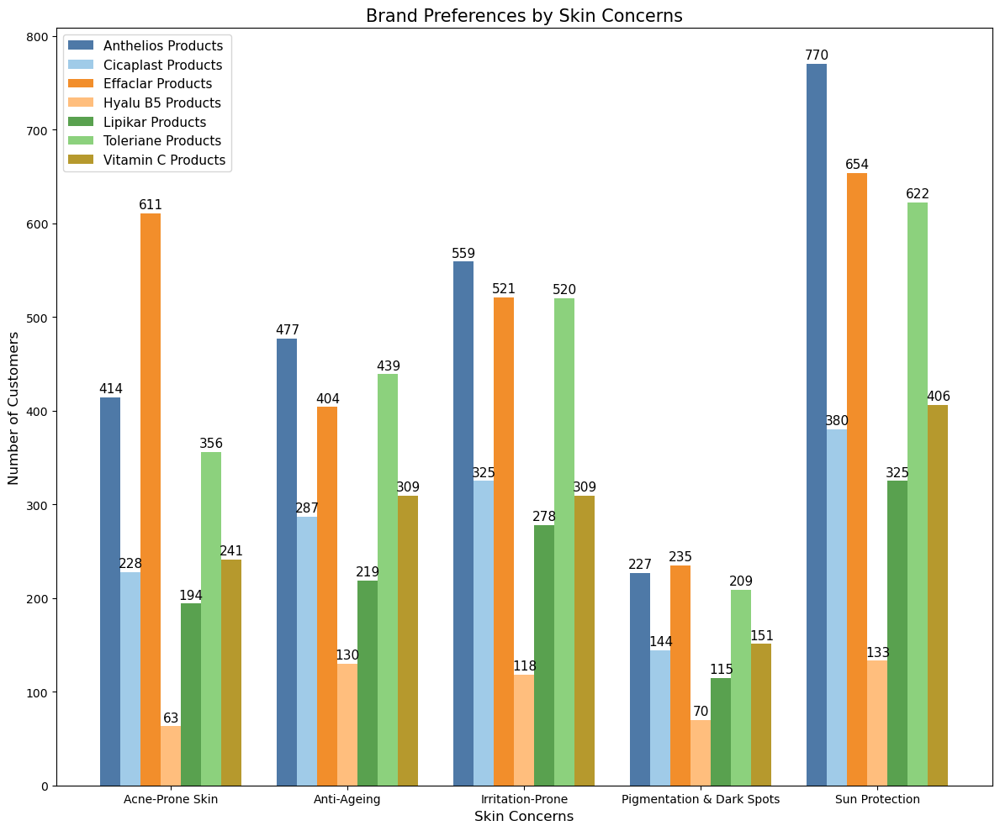

In [213]:
skin_concern_columns = [
    'SkinConcern_Acne-ProneSkin', 'SkinConcern_Anti-Ageing',
    'SkinConcern_Irritation-ProneSkin', 'SkinConcern_PigmentationandDarkSpots',
    'SkinConcern_SunProtection']

brand_skin_concern_summary = pd.DataFrame()

for brand in brand_columns:
    brand_skin_concern_summary[brand] = [
        df[df[skin_concern] == 1][brand].sum() for skin_concern in skin_concern_columns
    ]

brand_skin_concern_summary.index = [
   'Acne-Prone Skin', 'Anti-Ageing', 'Irritation-Prone', 'Pigmentation & Dark Spots', 'Sun Protection'
]
colors = ["#4E79A7",  "#A0CBE8",  "#F28E2B",  "#FFBE7D",  "#59A14F",  "#8CD17D",  "#B6992D"]

ax = brand_skin_concern_summary.rename(columns=custom_labels).plot(
    kind='bar',
    figsize=(12, 10),
    width=0.8,
    color=colors
)

plt.title('Brand Preferences by Skin Concerns', fontsize = 15)
plt.ylabel('Number of Customers', fontsize = 12)
plt.xlabel('Skin Concerns', fontsize = 12)
plt.xticks(rotation=0)
plt.legend(loc='upper left', fontsize = 11)

for container in ax.containers:
    ax.bar_label(container, label_type='edge', fontsize=11, padding=2)

plt.tight_layout()
plt.show()


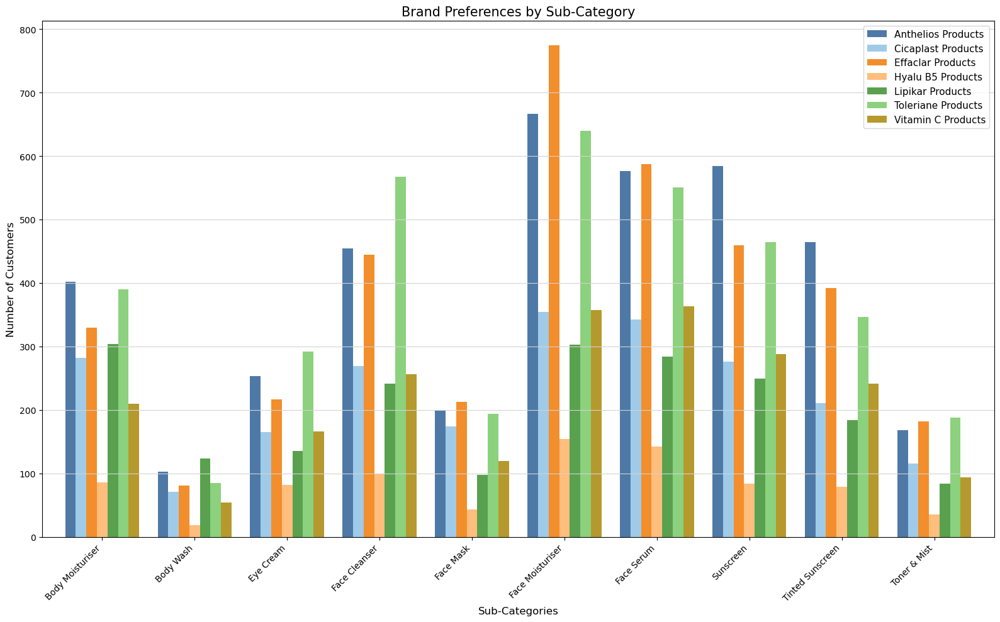

In [214]:
sub_category_columns = [
    'Sub-Category_BodyMoisturiser', 'Sub-Category_BodyWash', 'Sub-Category_EyeCream',
    'Sub-Category_FaceCleanser', 'Sub-Category_FaceMask', 'Sub-Category_FaceMoisturiser',
    'Sub-Category_FaceSerum', 'Sub-Category_Sunscreen', 'Sub-Category_TintedSunscreen', 'Sub-Category_Toner&Mist'
]

brand_sub_category_summary = pd.DataFrame()

for brand in brand_columns:
    brand_sub_category_summary[brand] = [
        df[df[sub_category] == 1][brand].sum() for sub_category in sub_category_columns
    ]

brand_sub_category_summary.index = [
    'Body Moisturiser', 'Body Wash', 'Eye Cream', 'Face Cleanser', 'Face Mask',
    'Face Moisturiser', 'Face Serum', 'Sunscreen', 'Tinted Sunscreen', 'Toner & Mist'
]
colors = ["#4E79A7",  "#A0CBE8",  "#F28E2B",  "#FFBE7D",  "#59A14F",  "#8CD17D",  "#B6992D"]

ax = brand_sub_category_summary.rename(columns=custom_labels).plot(
    kind='bar',
    figsize=(16, 10),
    width=0.8,
    color=colors
)

plt.title('Brand Preferences by Sub-Category', fontsize = 15)
plt.ylabel('Number of Customers', fontsize = 12)
plt.xlabel('Sub-Categories', fontsize = 12)
plt.xticks(rotation=45, ha='right')
plt.legend(fontsize = 11)
plt.grid(axis = 'y', color = 'lightgrey')

# for container in ax.containers:
#     for bar in container:
#         height = bar.get_height()
#         fontsize = max(8, min(12, height / 50))
#         ax.text(
#             bar.get_x() + bar.get_width() / 2,
#             height,
#             f'{int(height)}',
#             ha='center',
#             va='bottom',
#             fontsize=fontsize,
#         )

plt.tight_layout()
plt.show()

# 3. EDA

## 3.1. Customer retention


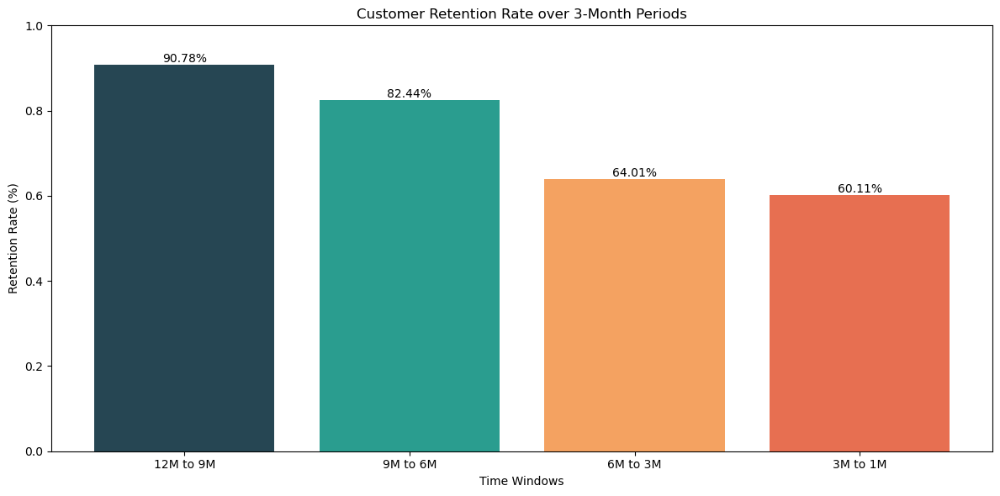

Customer Retention Analysis:
Of 5532 customers in 12M, 5022 (90.78%) returned in 9M
Of 5022 customers in 9M, 4140 (82.44%) returned in 6M
Of 4140 customers in 6M, 2650 (64.01%) returned in 3M
Of 2650 customers in 3M, 1593 (60.11%) returned in 1M


In [215]:
def analyze_customer_retention(df):
    windows = ['12M', '9M', '6M', '3M', '1M']

    # Count customers in each window
    window_counts = {w: df[f'Transaction_Count_{w}'].gt(0).sum() for w in windows}

    retention = {}
    for i, w in enumerate(windows[:-1]):
        next_w = windows[i+1]
        retained = df[(df[f'Transaction_Count_{w}'] > 0) & (df[f'Transaction_Count_{next_w}'] > 0)].shape[0]
        retention[f'{w}_to_{next_w}'] = retained / window_counts[w] if window_counts[w] > 0 else 0

    plt.figure(figsize=(12, 6))
    bars = plt.bar(retention.keys(), retention.values(), color =['#264653','#2A9D8F','#F4A261','#E76F51'])
    plt.title('Customer Retention Rate over 3-Month Periods')
    plt.xlabel('Time Windows')
    plt.ylabel('Retention Rate (%)')
    plt.ylim(0, 1)
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                 f'{height:.2%}', ha='center', va='bottom')
    plt.xticks(ticks=[0, 1, 2, 3], labels=['12M to 9M', '9M to 6M', '6M to 3M', '3M to 1M'])
    plt.tight_layout()
    plt.show()

    print("Customer Retention Analysis:")
    for k, v in retention.items():
        from_window, to_window = k.split('_to_')
        retained = int(v * window_counts[from_window])
        total = window_counts[from_window]
        print(f"Of {total} customers in {from_window}, {retained} ({v:.2%}) returned in {to_window}")


analyze_customer_retention(df)


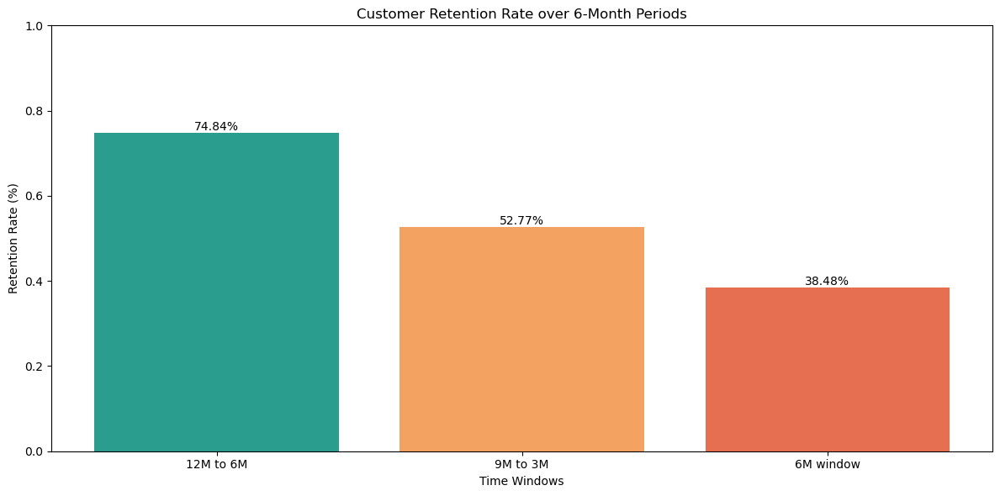

Customer Retention Analysis (6-Month Periods):
Of 5532 customers in 12M, 4140 (74.84%) returned in 6M
Of 5022 customers in 9M, 2650 (52.77%) returned in 3M
Of 4140 customers in 6M, 1593 (38.48%) returned in 1M


In [216]:
def analyze_customer_retention_6months(df):
    windows = {
        '12M_to_6M': ('12M', '6M'),
        '9M_to_3M': ('9M', '3M'),
        '6M_window': ('6M', '1M')
    }

    # Analyze retention for 6-month periods
    retention = {}
    for key, (start_w, end_w) in windows.items():
        retained = df[(df[f'Transaction_Count_{start_w}'] > 0) & (df[f'Transaction_Count_{end_w}'] > 0)].shape[0]
        total_customers = df[df[f'Transaction_Count_{start_w}'] > 0].shape[0]
        retention[key] = retained / total_customers if total_customers > 0 else 0

    plt.figure(figsize=(12, 6))
    bars = plt.bar(retention.keys(), retention.values(), color = ['#2A9D8F','#F4A261','#E76F51'])
    plt.title('Customer Retention Rate over 6-Month Periods')
    plt.xlabel('Time Windows')
    plt.ylabel('Retention Rate (%)')
    plt.ylim(0, 1)
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                 f'{height:.2%}', ha='center', va='bottom')
    plt.xticks(ticks=[0, 1, 2], labels=['12M to 6M', '9M to 3M', '6M window'])
    plt.tight_layout()
    plt.show()

    print("Customer Retention Analysis (6-Month Periods):")
    for k, v in retention.items():
        start_window, end_window = windows[k]
        retained = int(v * df[df[f'Transaction_Count_{start_window}'] > 0].shape[0])
        total = df[df[f'Transaction_Count_{start_window}'] > 0].shape[0]
        print(f"Of {total} customers in {start_window}, {retained} ({v:.2%}) returned in {end_window}")

analyze_customer_retention_6months(df)


## 3.2. Repeat purchase distribution

In [217]:
conditions = [
    (df['Transaction_Count_12M'] > df['Transaction_Count_9M']) & (df['Transaction_Count_9M'] > 0),
    (df['Transaction_Count_9M'] > df['Transaction_Count_6M']) & (df['Transaction_Count_6M'] > 0),
    (df['Transaction_Count_6M'] > df['Transaction_Count_3M']) & (df['Transaction_Count_3M'] > 0),
    (df['Transaction_Count_3M'] > df['Transaction_Count_1M']) & (df['Transaction_Count_1M'] > 0)
]

# Values for each condition
choices = [4, 3, 2, 1]

df['Repeat_Purchase'] = np.select(conditions, choices, default=0)

df['Repeat_Purchase'] = df['Repeat_Purchase'].fillna(0)

df['Repeat_Purchase'] = df['Repeat_Purchase'].astype(int)

print(df[['Transaction_Count_12M', 'Transaction_Count_9M', 'Transaction_Count_6M', 'Transaction_Count_3M', 'Transaction_Count_1M', 'Repeat_Purchase']].head())

   Transaction_Count_12M  Transaction_Count_9M  Transaction_Count_6M  \
0                      1                     1                     1   
1                      1                     1                     1   
2                      1                     1                     1   
3                      1                     1                     1   
4                      0                     0                     0   

   Transaction_Count_3M  Transaction_Count_1M  Repeat_Purchase  
0                     1                     1                0  
1                     0                     0                0  
2                     0                     0                0  
3                     1                     1                0  
4                     0                     0                0  


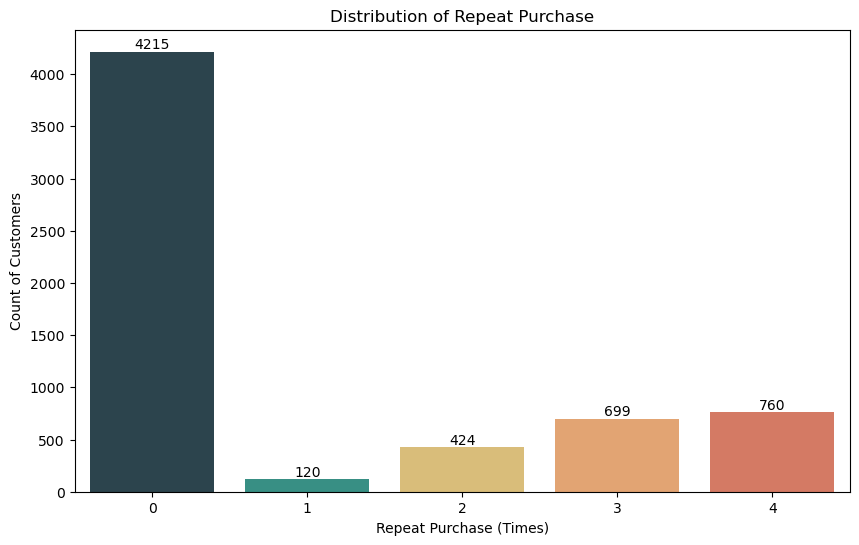

In [218]:
plt.figure(figsize=(10, 6))
ax = sns.countplot(x='Repeat_Purchase', data=df, palette=['#264653','#2A9D8F','#E9C46A','#F4A261','#E76F51'])

# Labels
for p in ax.patches:
    height = p.get_height()
    ax.text(
        p.get_x() + p.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom'
    )

plt.title('Distribution of Repeat Purchase')
plt.xlabel('Repeat Purchase (Times)')
plt.ylabel('Count of Customers')
plt.show()


In [219]:
# Add 'Repeat purchase' column
df.loc[df.index, 'Repeat_Purchase'] = df['Repeat_Purchase']

print(df[['Repeat_Purchase']].head(10))


   Repeat_Purchase
0                0
1                0
2                0
3                0
4                0
5                3
6                0
7                0
8                4
9                0


## 3.3. Location Analysis

In [220]:
import folium
from folium.plugins import MarkerCluster, HeatMap

city_postcode_range = {
    'Sydney': (2000, 2999),
    'Melbourne': (3000, 3999),
    'Brisbane': (4000, 4999),
    'Adelaide': (5000, 5999),
    'Perth': (6000, 6999),
    'Darwin': (8000, 8999),
    'Hobart': (7000, 7999),
    'Canberra': (2600, 2699),
    'Other': (0, 9999)  # Updated 'Other' to cover any postcode outside the specific ranges
}

# Function to map postcodes to cities
def map_postcode_to_city(postcode):
    for city, (start, end) in city_postcode_range.items():
        if start <= postcode <= end:
            return city
    return 'Other'

df['City'] = df['PostCode'].apply(map_postcode_to_city)

# Group sales data by city
city_sales = df.groupby('City')['Total_Spent_12M'].sum().reset_index()

# Corrected city coordinates dictionary
city_coordinates = {
    'Sydney': (-33.8688, 151.2093),
    'Melbourne': (-37.8136, 144.9631),
    'Brisbane': (-27.4698, 153.0251),
    'Adelaide': (-34.9285, 138.5999),
    'Perth': (-31.9505, 115.8605),
    'Darwin': (-12.4634, 130.8456),
    'Hobart': (-42.8821, 147.3272),
    'Canberra': (-35.2809, 149.1300),
    'Other': (-25.2744, 133.7751)  # Central Australia as the fallback for 'Other'
}

# Create a map centered around Australia
m = folium.Map(location=[-25.2744, 133.7751], zoom_start=4)

# Add markers for each city using MarkerCluster
marker_cluster = MarkerCluster().add_to(m)

# Iterate over the city sales and add markers to the map
for _, row in city_sales.iterrows():
    city_name = row['City']
    sales_value = row['Total_Spent_12M']
    location = city_coordinates.get(city_name, (-25.2744, 133.7751))  # Fallback to central Australia if not found
    folium.Marker(
        location=location,
        popup=f"{city_name}: ${sales_value:,.2f}",
        icon=folium.Icon(color='blue')
    ).add_to(marker_cluster)


# m.save('city_sales_map.html')
m

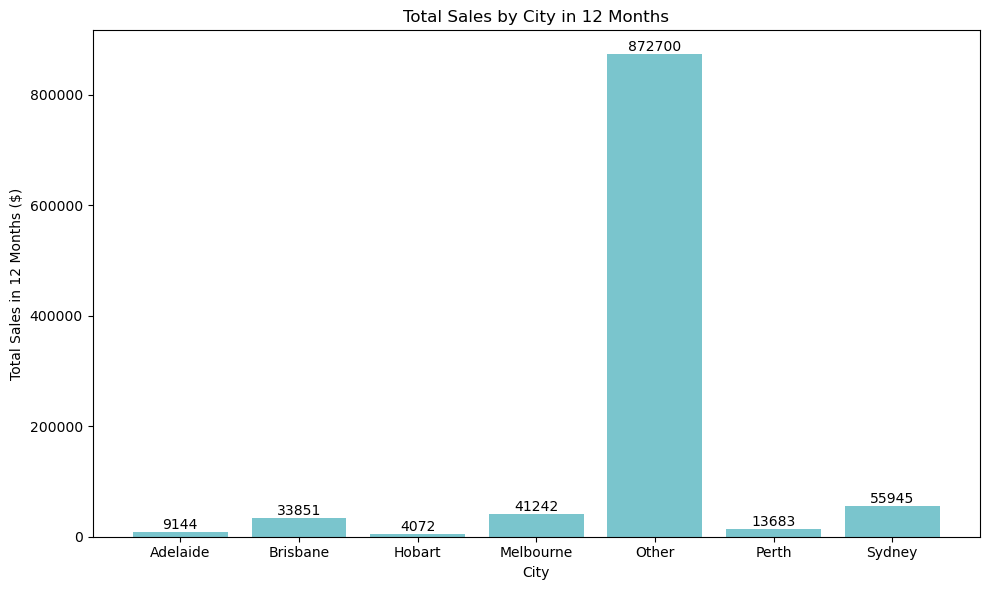

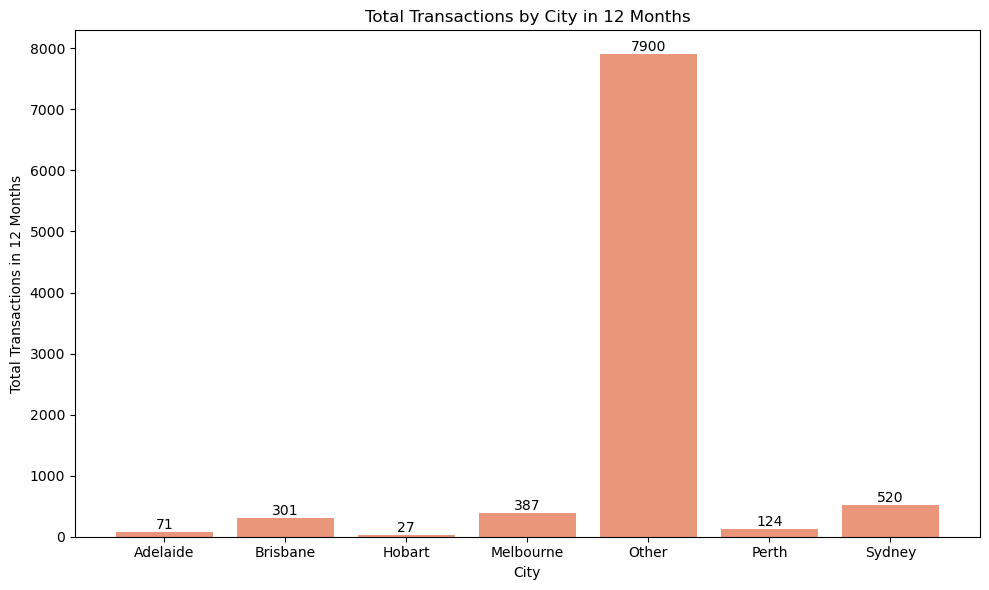

In [221]:
city_sales_transactions = df.groupby('City').agg({
    'Total_Spent_12M': 'sum',
    'Transaction_Count_12M': 'sum'
}).reset_index()

# Create a bar chart for total sales
fig, ax = plt.subplots(figsize=(10, 6))

# Group the data by city for total sales and total transactions
bars = ax.bar(city_sales_transactions['City'], city_sales_transactions['Total_Spent_12M'], color='#7ac5cd')
ax.set_xlabel('City')
ax.set_ylabel('Total Sales in 12 Months ($)')
ax.set_title('Total Sales by City in 12 Months')
ax.set_xticks(range(len(city_sales_transactions['City'])))
ax.set_xticklabels(city_sales_transactions['City'])

for bar in bars:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom'
    )

plt.tight_layout()
plt.show()

# Create a bar chart for total transactions
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(city_sales_transactions['City'], city_sales_transactions['Transaction_Count_12M'], color='#e9967a')
ax.set_xlabel('City')
ax.set_ylabel('Total Transactions in 12 Months')
ax.set_title('Total Transactions by City in 12 Months')
ax.set_xticks(range(len(city_sales_transactions['City'])))
ax.set_xticklabels(city_sales_transactions['City'])

for bar in bars:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom'
    )

plt.tight_layout()
plt.show()


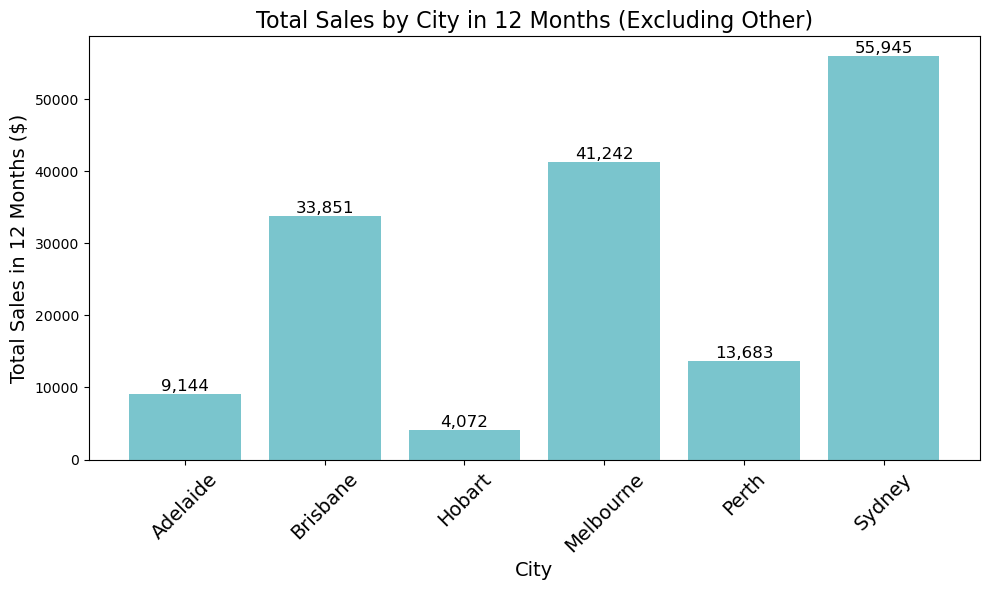

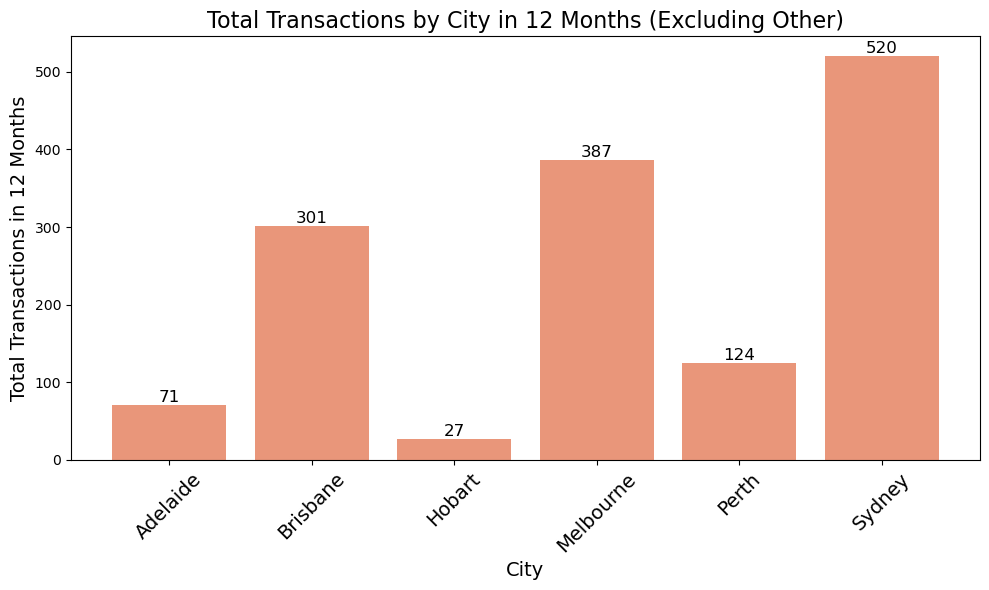

In [222]:
city_sales_transactions_filtered = city_sales_transactions[city_sales_transactions['City'] != 'Other']

# Create a bar chart for total sales excluding 'Other'
plt.figure(figsize=(10, 6))
bars = plt.bar(city_sales_transactions_filtered['City'], city_sales_transactions_filtered['Total_Spent_12M'], color='#7ac5cd')
plt.xlabel('City',fontsize=14)
plt.ylabel('Total Sales in 12 Months ($)',fontsize=14 )
plt.title('Total Sales by City in 12 Months (Excluding Other)',fontsize=16)
plt.xticks(rotation=45, fontsize= 14 )

# Add labels on the bars
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height):,}',  # Add comma formatting for large numbers
        ha='center',
        va='bottom',
        fontsize=12
    )

plt.tight_layout()
plt.show()

# Transcation Count
plt.figure(figsize=(10, 6))
bars = plt.bar(city_sales_transactions_filtered['City'], city_sales_transactions_filtered['Transaction_Count_12M'], color='#e9967a')
plt.xlabel('City',fontsize=14 )
plt.ylabel('Total Transactions in 12 Months',fontsize=14 )
plt.title('Total Transactions by City in 12 Months (Excluding Other)',fontsize=16 )
plt.xticks(rotation=45, fontsize=14 )

for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom',
        fontsize=12
    )

plt.tight_layout()
plt.show()

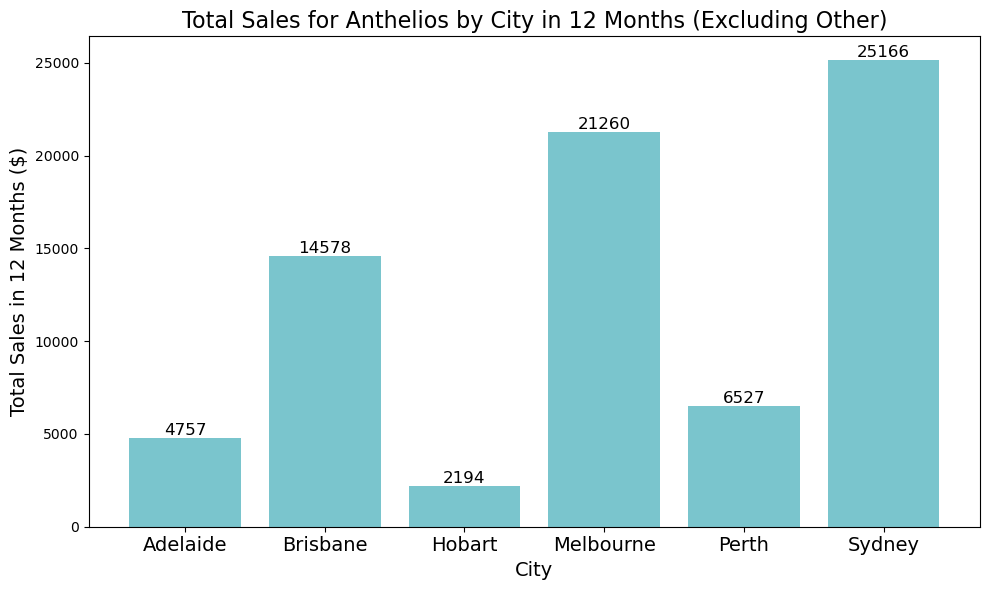

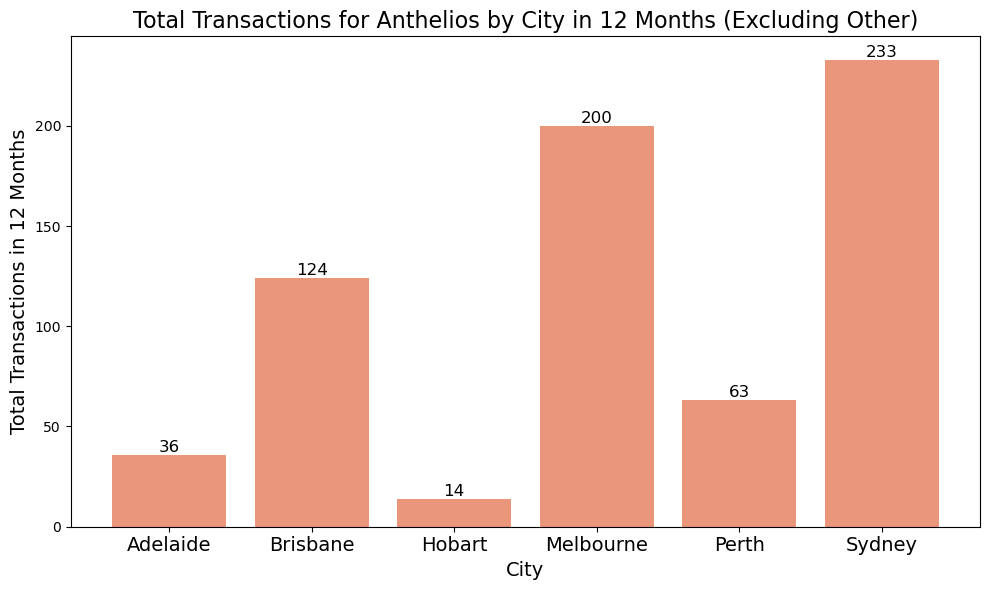

In [223]:
df_anthelios = df[df['BrandDescription_Anthelios_Output'] == 1].copy()

# Map postcodes to cities for Anthelios data
df_anthelios['City'] = df_anthelios['PostCode'].apply(map_postcode_to_city)

# Group the Anthelios data by city for total sales and total transactions
city_sales_transactions_anthelios = df_anthelios.groupby('City').agg({
    'Total_Spent_12M': 'sum',
    'Transaction_Count_12M': 'sum'
}).reset_index()

city_sales_transactions_anthelios_filtered = city_sales_transactions_anthelios[city_sales_transactions_anthelios['City'] != 'Other']

# Bar chart for total sales excluding 'Other' for Anthelios
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(city_sales_transactions_anthelios_filtered['City'], city_sales_transactions_anthelios_filtered['Total_Spent_12M'], color='#7ac5cd')
ax.set_xlabel('City',fontsize=14)
ax.set_ylabel('Total Sales in 12 Months ($)',fontsize=14)
ax.set_title('Total Sales for Anthelios by City in 12 Months (Excluding Other)',fontsize=16)
ax.set_xticks(range(len(city_sales_transactions_anthelios_filtered['City'])))
ax.set_xticklabels(city_sales_transactions_anthelios_filtered['City'],fontsize=14)

for bar in bars:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom',
        fontsize=12
    )

plt.tight_layout()
plt.show()


# Bar chart for total transactions excluding 'Other' for Anthelios
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(city_sales_transactions_anthelios_filtered['City'], city_sales_transactions_anthelios_filtered['Transaction_Count_12M'], color='#e9967a')
ax.set_xlabel('City',fontsize=14)
ax.set_ylabel('Total Transactions in 12 Months',fontsize=14)
ax.set_title('Total Transactions for Anthelios by City in 12 Months (Excluding Other)',fontsize=16)
ax.set_xticks(range(len(city_sales_transactions_anthelios_filtered['City'])))
ax.set_xticklabels(city_sales_transactions_anthelios_filtered['City'],fontsize=14)

for bar in bars:
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f'{int(height)}',
        ha='center',
        va='bottom',
        fontsize=12
    )

plt.tight_layout()
plt.show()


## 3.4. Accuracy of Logistic Regression Models by Time Window and Product Ranges

In [224]:
df['churn'] = df[['BrandDescription_Anthelios_Output', 'BrandDescription_Cicaplast_Output', 'BrandDescription_Effaclar_Output','BrandDescription_HyaluB5_Output','BrandDescription_Lipikar_Output','BrandDescription_Toleriane_Output','BrandDescription_VitaminC_Output']].max(axis=1).astype('int64')

df['Transaction_Count_12M_6M'] = df['Transaction_Count_12M'] - df['Transaction_Count_6M']
df['Total_Spent_12M_6M'] = df['Total_Spent_12M'] - df['Total_Spent_6M']


feature_columns = {
    '1M': ['Transaction_Count_1M', 'Total_Spent_1M'],
    '3M': ['Transaction_Count_3M', 'Total_Spent_3M'],
    '6M': ['Transaction_Count_6M', 'Total_Spent_6M'],
    '9M': ['Transaction_Count_9M', 'Total_Spent_9M'],
    '12M': ['Transaction_Count_12M', 'Total_Spent_12M'],
    '12M-6M': ['Transaction_Count_12M_6M', 'Total_Spent_12M_6M'],
}

accuracy_list = []

for name, cols in feature_columns.items():
    X = df[cols]
    y = df['churn']


    model = LogisticRegression()
    model.fit(X,y)
    y_pred = model.predict(X)

    accuracy = accuracy_score(y, y_pred)
    accuracy_list.append({'Timeframe': name, 'Accuracy': accuracy})

accuracy_df = pd.DataFrame(accuracy_list)
print(accuracy_df)




  Timeframe  Accuracy
0        1M  0.837086
1        3M  0.837086
2        6M  0.837086
3        9M  0.837086
4       12M  0.837086
5    12M-6M  0.837086


In [225]:
output_col = ['BrandDescription_Anthelios_Output', 'BrandDescription_Cicaplast_Output', 'BrandDescription_Effaclar_Output','BrandDescription_HyaluB5_Output','BrandDescription_Lipikar_Output','BrandDescription_Toleriane_Output','BrandDescription_VitaminC_Output']

feature_columns = {
    '1M': ['Transaction_Count_1M', 'Total_Spent_1M'],
    '3M': ['Transaction_Count_3M', 'Total_Spent_3M'],
    '6M': ['Transaction_Count_6M', 'Total_Spent_6M'],
    '9M': ['Transaction_Count_9M', 'Total_Spent_9M'],
    '12M': ['Transaction_Count_12M', 'Total_Spent_12M'],
    '12M-6M': ['Transaction_Count_12M_6M', 'Total_Spent_12M_6M'],
}

accuracy_list= []

for item in output_col:
    output = df[item]

    for name, cols in feature_columns.items():
        X = df[cols]
        y = output


        model = LogisticRegression()
        model.fit(X,y)
        y_pred = model.predict(X)

        accuracy = accuracy_score(y, y_pred)

        accuracy_list.append({'Timeframe': name, 'Accuracy': accuracy, 'Product': item})

accuracy_df = pd.DataFrame(accuracy_list)
print(accuracy_df)


   Timeframe  Accuracy                            Product
0         1M  0.562560  BrandDescription_Anthelios_Output
1         3M  0.562399  BrandDescription_Anthelios_Output
2         6M  0.562399  BrandDescription_Anthelios_Output
3         9M  0.563525  BrandDescription_Anthelios_Output
4        12M  0.564651  BrandDescription_Anthelios_Output
5     12M-6M  0.563043  BrandDescription_Anthelios_Output
6         1M  0.755388  BrandDescription_Cicaplast_Output
7         3M  0.755066  BrandDescription_Cicaplast_Output
8         6M  0.755227  BrandDescription_Cicaplast_Output
9         9M  0.755227  BrandDescription_Cicaplast_Output
10       12M  0.755227  BrandDescription_Cicaplast_Output
11    12M-6M  0.755227  BrandDescription_Cicaplast_Output
12        1M  0.587166   BrandDescription_Effaclar_Output
13        3M  0.587166   BrandDescription_Effaclar_Output
14        6M  0.587005   BrandDescription_Effaclar_Output
15        9M  0.587166   BrandDescription_Effaclar_Output
16       12M  

In [226]:
accuracy_df['Accuracy'] = pd.to_numeric(accuracy_df['Accuracy'], errors='coerce')

accuracy_df['Accuracy_Text'] = accuracy_df['Accuracy'].apply(lambda x: f'{x:.5f}')

custom_labels = {
    'BrandDescription_Anthelios_Output': 'Anthelios Products',
    'BrandDescription_Cicaplast_Output': 'Cicaplast Products',
    'BrandDescription_Effaclar_Output': 'Effaclar Products',
    'BrandDescription_HyaluB5_Output': 'Hyalu B5 Products',
    'BrandDescription_Lipikar_Output': 'Lipikar Products',
    'BrandDescription_Toleriane_Output': 'Toleriane Products',
    'BrandDescription_VitaminC_Output': 'Vitamin C Products'
}

accuracy_df['Product_Label'] = accuracy_df['Product'].map(custom_labels)

fig = px.bar(accuracy_df, x='Timeframe', y='Accuracy', color='Product_Label',
             barmode='group',
             labels = {'Product_Label': 'Products'},
             title='Accuracy of Logistic Regression Models by Time Window and Product Ranges',
             text='Accuracy_Text')

fig.update_traces(texttemplate='%{text}', textposition='inside', textfont_size=30)

fig.update_layout(xaxis_title="Time Windows")

fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=0.99,
    xanchor="right",
    x=1,
))

# Show the plot
fig.show()


Anthelios: Use the 12M timeframe.
Cicaplast: Use the 12M-6M timeframe.
Effaclar: Use the 12M-6M timeframe.
Hyalu B5: Use the 9M timeframe.
Lipikar: Use either the 6M or 12M-6M timeframe.
Toleriane: Use the 9M timeframe.
Vitamin C: Use either the 12M or 12M-6M timeframe. <br />  This suggests that using data from the past 12 months might yield the best results for these products. cause it onsistently provides strong accuracy across most product.The 12M timeframe offers robust and consistently good performance for all products, making it the best overall choice when modeling with a single timeframe across the dataset.

# 4. Feature engineering

## 4.1. Segmenting by total spent

K means Method

/Users/quyentran/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/Users/quyentran/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/Users/quyentran/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/Users/quyentran/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/Users/quyentran/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarn

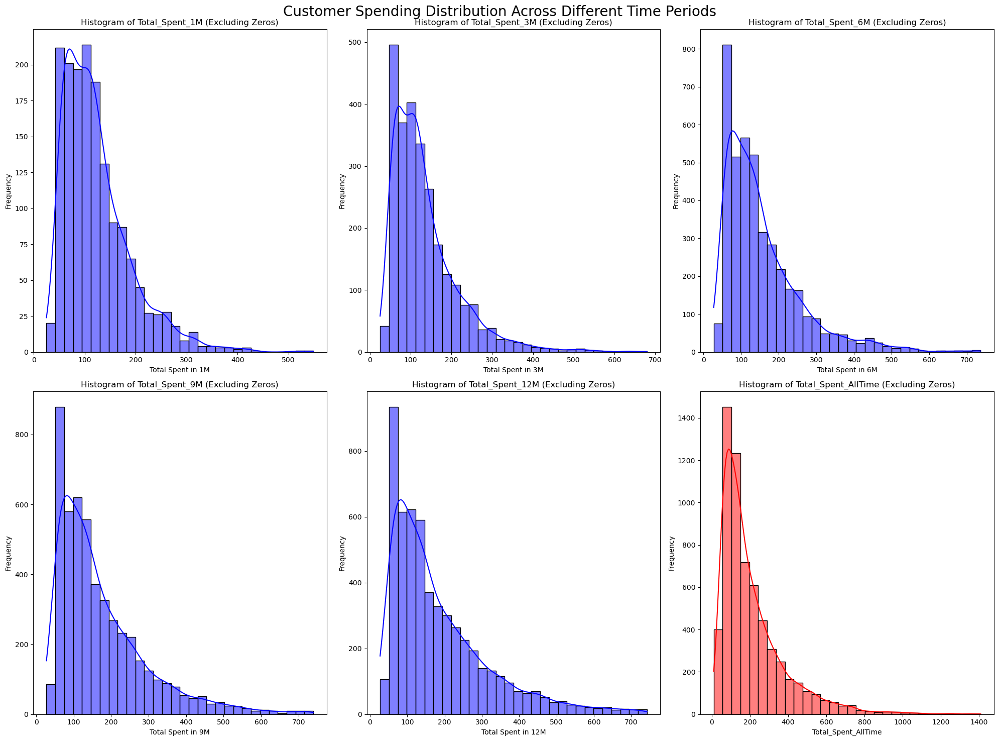

In [227]:
dependent_variable = 'Total_Spent_AllTime'
time_periods = ['1M', '3M', '6M', '9M', '12M']
plt.figure(figsize=(20, 15))

for i, period in enumerate(time_periods):
    plt.subplot(2, 3, i + 1)

    # Filter out rows where Total_Spent_{period} is zero
    filtered_data = df[df[f'Total_Spent_{period}'] > 0]

    sns.histplot(filtered_data[f'Total_Spent_{period}'], bins=30, kde=True, color='blue')
    plt.title(f'Histogram of Total_Spent_{period} (Excluding Zeros)')
    plt.xlabel(f'Total Spent in {period}')
    plt.ylabel('Frequency')

# Add a histogram for the overall Total_Spent_AllTime, excluding zeros
plt.subplot(2, 3, len(time_periods) + 1)
filtered_alltime_data = df[df[dependent_variable] > 0]
sns.histplot(filtered_alltime_data[dependent_variable], bins=30, kde=True, color='red')
plt.title(f'Histogram of {dependent_variable} (Excluding Zeros)')
plt.xlabel(f'{dependent_variable}')
plt.ylabel('Frequency')

plt.suptitle('Customer Spending Distribution Across Different Time Periods', fontsize=20)
plt.tight_layout()
plt.savefig('histogram_total_spent_excluding_zeros.png')
plt.show()

/Users/quyentran/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/quyentran/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/quyentran/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/quyentran/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/quyentran/anaconda3/lib/python3.11/site-packages/skle

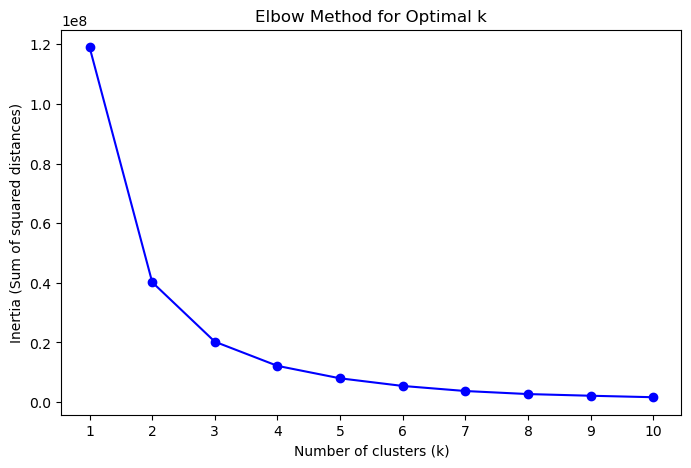

In [228]:
k_values = range(1, 11)
inertia_values = []

X = df[['Total_Spent_12M']].values

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X)
    inertia_values.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_values, inertia_values, 'bo-')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia (Sum of squared distances)')
plt.xticks(k_values)
plt.show()

Since the elbow occurred around 3, the number of cluster we will be using for defining spending group would be 3.

In [229]:
# Segmenting by spenders
df_filtered = df[df['Total_Spent_12M'] > 0].copy()

X = df_filtered[['Total_Spent_12M']].values

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=3, random_state=0)
df_filtered['Spending_Cluster'] = kmeans.fit_predict(X_scaled)

# Mean of each cluster spending
cluster_means = df_filtered.groupby('Spending_Cluster')['Total_Spent_12M'].mean().sort_values()
print("Cluster means:")
print(cluster_means)

def map_cluster_to_category(cluster, cluster_means):
    if cluster == cluster_means.idxmin():
        return 'Low'
    elif cluster == cluster_means.idxmax():
        return 'High'
    else:
        return 'Medium'

df_filtered.loc[:, 'Spending_Category'] = df_filtered['Spending_Cluster'].apply(lambda x: map_cluster_to_category(x, cluster_means))
print(df_filtered[['Total_Spent_12M', 'Spending_Cluster', 'Spending_Category']].head(15))



/Users/quyentran/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Cluster means:
Spending_Cluster
0    103.719621
2    260.394655
1    504.557960
Name: Total_Spent_12M, dtype: float64
    Total_Spent_12M  Spending_Cluster Spending_Category
0            143.00                 0               Low
1            189.36                 2            Medium
2            161.59                 0               Low
3             73.62                 0               Low
5            564.34                 1              High
7            107.90                 0               Low
8            114.75                 0               Low
9            105.70                 0               Low
10            96.85                 0               Low
11            45.90                 0               Low
12           162.75                 0               Low
13           131.81                 0               Low
14           223.00                 2            Medium
15            51.96                 0               Low
16           158.11                 0     

In [230]:
# Min and max spending
cluster_ranges = df_filtered.groupby('Spending_Cluster')[['Total_Spent_12M']].agg(['min', 'max'])
print(cluster_ranges)

# Sort by mean spending
cluster_order = df_filtered.groupby('Spending_Cluster')['Total_Spent_12M'].mean().sort_values().index

categories = ['Low Spender', 'Medium Spender', 'High Spender']
cluster_category_map = dict(zip(cluster_order, categories))

df_filtered['Spending_Category'] = df_filtered['Spending_Cluster'].map(cluster_category_map)

# Mean spending in each category
category_means = df_filtered.groupby('Spending_Category')[['Total_Spent_12M']].mean().round(2)
print(category_means)

# Percentage of customers in each category
category_distribution = df_filtered['Spending_Category'].value_counts(normalize=True).round(4) * 100
print("\nPercentage of customers in each Spending Category:")
print(category_distribution)


                 Total_Spent_12M        
                             min     max
Spending_Cluster                        
0                          27.16  182.38
1                         383.43  742.14
2                         182.61  382.15
                   Total_Spent_12M
Spending_Category                 
High Spender                504.56
Low Spender                 103.72
Medium Spender              260.39

Percentage of customers in each Spending Category:
Spending_Category
Low Spender       61.51
Medium Spender    29.36
High Spender       9.13
Name: proportion, dtype: float64


In [231]:
fig = px.box(
    df_filtered,
    x='Spending_Category',
    y='Total_Spent_12M',
    category_orders={'Spending_Category': ['Low Spender', 'Medium Spender', 'High Spender']},
    title='Distribution of Total Spent in 12 Months by Spending Category',
    labels={
        'Spending_Category': 'Spending Category',
        'Total_Spent_12M': 'Total Spent in 12 Months'
    },
    width=900,
    height=600,
    color='Spending_Category',
    color_discrete_map={
        'Low Spender': '#1f77b4',
        'Medium Spender': '#ff7f0e',
        'High Spender': '#2ca02c'
    }
)

fig.update_layout(
    xaxis_title="Spending Category",
    yaxis_title="Total Spent in 12 Months",
    font=dict(size=12),
    title=dict(font=dict(size=16)),
    boxmode='overlay',
    boxgap=0.3,
)

fig.show()

summary_stats = df_filtered.groupby('Spending_Category')['Total_Spent_12M'].describe()
print(summary_stats)


                    count        mean        std     min       25%     50%  \
Spending_Category                                                            
High Spender        505.0  504.557960  96.043224  383.43  428.5300  476.96   
Low Spender        3403.0  103.719621  38.064954   27.16   71.9000  100.90   
Medium Spender     1624.0  260.394655  55.272934  182.61  213.0525  251.82   

                      75%     max  
Spending_Category                  
High Spender       566.04  742.14  
Low Spender        136.90  182.38  
Medium Spender     301.72  382.15  


In [232]:
# Add 'Spending_Category' column from df_filtered to df
df.loc[df_filtered.index, 'Spending_Category'] = df_filtered['Spending_Category']

print(df[['Total_Spent_12M', 'Spending_Category']].head(10))


   Total_Spent_12M Spending_Category
0           143.00       Low Spender
1           189.36    Medium Spender
2           161.59       Low Spender
3            73.62       Low Spender
4             0.00               NaN
5           564.34      High Spender
6             0.00               NaN
7           107.90       Low Spender
8           114.75       Low Spender
9           105.70       Low Spender


In [233]:
df['Spending_Category'] = df['Spending_Category'].fillna('Inactive')
df['Spending_Category']

0          Low Spender
1       Medium Spender
2          Low Spender
3          Low Spender
4             Inactive
             ...      
6395       Low Spender
6396       Low Spender
6397       Low Spender
6398       Low Spender
6399       Low Spender
Name: Spending_Category, Length: 6218, dtype: object

## 4.2. Handling postcode

In [234]:
postcode_list = set(df_postcode['Postcode \ MOSAIC code'].unique())

In [235]:
#cleaning postcode (deleting those that are not real australian postcode, not delete the null one)
df['PostCode'] = df['PostCode'].astype('Int64')
print(df['PostCode'].unique().tolist())

[<NA>, 4113, 3006, 2250, 4814, 2765, 2261, 2000, 4161, 6722, 6163, 3011, 4520, 6107, 4101, 2095, 4455, 4054, 4123, 3806, 5081, 3224, 6010, 2604, 6112, 2602, 6104, 2282, 5290, 3810, 3216, 2206, 2483, 4723, 2153, 3032, 3987, 2611, 3021, 6230, 6065, 2015, 2480, 4220, 3000, 2077, 3030, 3102, 2020, 2145, 2570, 6062, 2148, 2320, 3741, 6000, 2204, 6556, 3165, 4120, 6061, 3020, 4504, 5453, 3912, 2026, 3108, 2203, 2117, 2071, 3051, 5039, 4700, 4121, 5032, 4133, 2120, 7018, 3337, 2068, 3150, 4051, 4074, 7000, 2122, 2284, 3205, 6018, 2144, 4305, 2089, 3805, 3127, 7330, 2018, 2036, 2518, 2090, 3173, 2111, 3072, 4060, 3056, 2515, 4518, 4615, 2487, 4870, 3820, 4509, 3280, 4208, 3144, 3155, 4127, 4610, 2291, 2558, 2065, 2601, 2170, 6004, 3168, 2880, 2041, 2154, 3015, 2443, 2147, 2019, 3060, 3803, 3058, 4006, 2750, 3340, 4152, 2216, 3124, 5108, 3083, 6152, 6100, 2137, 2114, 3204, 5038, 2230, 3170, 4020, 4563, 5034, 4806, 2905, 4825, 3128, 4507, 4553, 2396, 4300, 5352, 3196, 3753, 4217, 4800, 3181, 252

In [236]:
def is_valid_postcode(postcode):
    if pd.isna(postcode):
        return True
    #postcode_str = str(postcode)
    return postcode in postcode_list

df['ValidPostcode'] = df['PostCode'].apply(is_valid_postcode)

df_cleaned = df[df['ValidPostcode']]

df_cleaned = df_cleaned.drop('ValidPostcode', axis=1)

print(df_cleaned['PostCode'].unique().tolist())

[<NA>, 4113, 3006, 2250, 4814, 2765, 2261, 2000, 4161, 6722, 6163, 3011, 4520, 6107, 4101, 2095, 4455, 4054, 4123, 3806, 5081, 3224, 6010, 2604, 6112, 2602, 6104, 2282, 5290, 3810, 3216, 2206, 2483, 4723, 2153, 3032, 3987, 2611, 3021, 6230, 6065, 2015, 2480, 4220, 3000, 2077, 3030, 3102, 2020, 2145, 2570, 6062, 2148, 2320, 3741, 6000, 2204, 6556, 3165, 4120, 6061, 3020, 4504, 5453, 3912, 2026, 3108, 2203, 2117, 2071, 3051, 5039, 4700, 4121, 5032, 4133, 2120, 7018, 3337, 2068, 3150, 4051, 4074, 7000, 2122, 2284, 3205, 6018, 2144, 4305, 2089, 3805, 3127, 7330, 2018, 2036, 2518, 2090, 3173, 2111, 3072, 4060, 3056, 2515, 4518, 4615, 2487, 4870, 3820, 4509, 3280, 4208, 3144, 3155, 4127, 4610, 2291, 2558, 2065, 2601, 2170, 6004, 3168, 2880, 2041, 2154, 3015, 2443, 2147, 2019, 3060, 3803, 3058, 4006, 2750, 3340, 4152, 2216, 3124, 5108, 3083, 6152, 6100, 2137, 2114, 3204, 5038, 2230, 3170, 4020, 4563, 5034, 4806, 2905, 4825, 3128, 4507, 4553, 2396, 4300, 5352, 3196, 3753, 4217, 4800, 3181, 252

In [237]:
postcode_count = df_cleaned['PostCode'].count()
postcode_count

1039

In [238]:
print(f'Original Dataset: {df.shape}')
print(f'New Dataset: {df_cleaned.shape}')

Original Dataset: (6218, 72)
New Dataset: (6216, 71)


In [239]:
#Checking the invalid postcodes, which are not Australian postcode
df[df['ValidPostcode'] == False]['PostCode']

1439    96766
4430     1730
Name: PostCode, dtype: Int64

In [240]:
df_postcode

,Postcode \ MOSAIC code,A,B,C,D,E,F,G,H,I,...,L42,M43,M44,M45,M46,M47,N48,N49,N50,N51
0,800,11.0,NaN,2816.0,1.0,NaN,41.0,1300.0,3.0,NaN,...,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,2.0,NaN
1,810,225.0,3423.0,NaN,529.0,308.0,3137.0,1421.0,132.0,2273.0,...,NaN,NaN,105.0,217.0,79.0,6.0,1.0,NaN,NaN,NaN
2,812,71.0,1649.0,NaN,187.0,166.0,902.0,6.0,192.0,2669.0,...,NaN,NaN,45.0,142.0,46.0,6.0,10.0,NaN,NaN,NaN
3,820,784.0,455.0,585.0,115.0,96.0,4763.0,2284.0,121.0,140.0,...,NaN,NaN,17.0,101.0,102.0,4.0,4.0,NaN,NaN,NaN
4,822,3.0,NaN,NaN,43.0,441.0,1.0,2.0,356.0,6.0,...,2.0,NaN,3.0,77.0,NaN,3.0,2247.0,94.0,600.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2628,7466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,122.0
2629,7467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,...,NaN,NaN,NaN,NaN,NaN,2.0,3.0,NaN,1.0,74.0
2630,7468,NaN,NaN,NaN,1.0,NaN,NaN,NaN,15.0,8.0,...,NaN,NaN,NaN,NaN,NaN,7.0,4.0,NaN,126.0,195.0
2631,7469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,1.0,5.0,1.0,408.0


### 4.2.1. Sort postcodes into Mosaic groups for profiling

In [241]:
df_postcode_grouped = df_postcode.copy()

df_postcode_grouped['Total Value'] = df_postcode.iloc[:, 1:].sum(axis=1, skipna=True)

df_postcode_grouped['Max Value'] = df_postcode.iloc[:, 1:-1].max(axis=1, skipna=True)
df_postcode_grouped['Max Group'] = df_postcode.iloc[:, 1:-1].idxmax(axis=1, skipna=True)

# Calculate the percentage of the max value in the total value
df_postcode_grouped['Percentage'] = df_postcode_grouped['Max Value'] / df_postcode_grouped['Total Value']

# Find the second max value and corresponding group only if percentage is less than 80%
def assign_group(row):
    value = row.iloc[1:-4].astype(float)
    if row['Percentage'] >= 0.5:
        return None
    else:
        # Find the second max group and value if less than 80%
        second_max_value = value.nlargest(2)
        second_group = value.nlargest(2).index[-1]
        return second_group

df_postcode_grouped['Second Group'] = df_postcode_grouped.apply(assign_group, axis=1)

result = df_postcode_grouped[['Postcode \ MOSAIC code', 'Total Value', 'Max Value', 'Max Group', 'Percentage', 'Second Group']]
print(result.head(30))


    Postcode \ MOSAIC code  Total Value  Max Value Max Group  Percentage  \
0                      800       8398.0     2816.0         C    0.335318   
1                      810      27424.0     3423.0         B    0.124818   
2                      812      14148.0     2669.0         I    0.188649   
3                      820      21566.0     4763.0         F    0.220857   
4                      822       7816.0     2948.0         N    0.377175   
5                      828       1698.0      257.0         K    0.151355   
6                      829        424.0       52.0         M    0.122642   
7                      830      15430.0     2108.0         B    0.136617   
8                      832      15046.0     2685.0         B    0.178453   
9                      834        756.0      316.0         E    0.417989   
10                     835       1506.0      704.0         E    0.467463   
11                     836       3676.0     1602.0         E    0.435800   
12          

In [242]:
df_merged = pd.merge(
    df_cleaned,
    df_postcode_grouped[['Postcode \ MOSAIC code', 'Total Value', 'Max Value', 'Max Group', 'Second Group']],
    how='left',
    left_on='PostCode',
    right_on='Postcode \ MOSAIC code'
)


In [250]:
# Group by both 'Max Group' and 'Second Group' and count occurrences
group_counts = df_merged.groupby(['Max Group', 'Second Group']).size().reset_index(name='Count')

fig = px.bar(group_counts, x='Max Group', y='Count',
             color='Second Group',
             hover_data=['Count'],
             labels={'Max Group': 'Mosaic Groups', 'Count': 'Count'},
             title='Count of Total Value in Mosaic Groups Stacked by Sub-Group',
             height=400, text='Second Group')

fig.update_traces(textposition='inside', texttemplate='%{text}',
                  selector=dict(type='bar'))

fig.update_traces(textangle=0, textfont_size=12)

fig.update_layout(
    width=800,
    height=500,
    showlegend = False
)

fig.show()


In [249]:
grouped_data = df_merged.groupby('Max Group').agg({
    'Transaction_Count_12M': 'sum',
    'Total_Spent_12M': 'mean'
}).reset_index()

fig = px.scatter(grouped_data, x='Transaction_Count_12M', y='Total_Spent_12M',
                 color='Max Group', hover_name='Max Group', text='Max Group',
                 labels={'Transaction_Count_12M': 'Transaction Count 12M',
                         'Total_Spent_12M': 'Total Spent 12M',
                        'Max Group': 'Group'},
                 title='Total Transaction Count (12M) vs Average Total Spent (12M) by Mosaic Groups'
                )

fig.update_traces(textposition='bottom right', marker_size=10)

fig.update_layout(
    xaxis_title='Transaction Count 12M',
    yaxis_title='Average Total Spent 12M ($)',
    plot_bgcolor='white',
    showlegend=False,
    xaxis=dict(
        showgrid=True,
        gridcolor='LightGray',
        gridwidth=1
    ),
    yaxis=dict(
        showgrid=True,
        gridcolor='LightGray',
        gridwidth=1
    ),
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
    ),
    title_font_size=20
)

fig.show()


In [245]:
df = df_merged.copy()
df.head(10)

,Total_Spent_1M,Transaction_Count_1M,Total_Spent_3M,Transaction_Count_3M,Total_Spent_6M,Transaction_Count_6M,Total_Spent_9M,Transaction_Count_9M,Total_Spent_12M,Transaction_Count_12M,...,City,churn,Transaction_Count_12M_6M,Total_Spent_12M_6M,Spending_Category,Postcode \ MOSAIC code,Total Value,Max Value,Max Group,Second Group
0,143.00,1,143.00,1,143.00,1,143.00,1,143.00,1,...,Other,1,0,0.00,Low Spender,NaN,NaN,NaN,NaN,NaN
1,0.00,0,0.00,0,189.36,1,189.36,1,189.36,1,...,Other,1,0,0.00,Medium Spender,NaN,NaN,NaN,NaN,NaN
2,0.00,0,0.00,0,161.59,1,161.59,1,161.59,1,...,Other,1,0,0.00,Low Spender,NaN,NaN,NaN,NaN,NaN
3,73.62,1,73.62,1,73.62,1,73.62,1,73.62,1,...,Other,1,0,0.00,Low Spender,NaN,NaN,NaN,NaN,NaN
4,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,...,Other,1,0,0.00,Inactive,NaN,NaN,NaN,NaN,NaN
5,115.12,1,115.12,1,378.10,3,564.34,4,564.34,4,...,Other,1,1,186.24,High Spender,NaN,NaN,NaN,NaN,NaN
6,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,...,Brisbane,1,0,0.00,Inactive,4113.0,21544.0,2382.0,K,I
7,107.90,1,107.90,1,107.90,1,107.90,1,107.90,1,...,Other,1,0,0.00,Low Spender,NaN,NaN,NaN,NaN,NaN
8,0.00,0,0.00,0,70.85,1,70.85,1,114.75,2,...,Other,1,1,43.90,Low Spender,NaN,NaN,NaN,NaN,NaN
9,105.70,1,105.70,1,105.70,1,105.70,1,105.70,1,...,Other,1,0,0.00,Low Spender,NaN,NaN,NaN,NaN,NaN


### 4.2.2. Proportion of Buying by MOSAIC Groups vs. Target Variables (in %)

In [246]:
df[binary_col] = binary_target

In [247]:
# Count the number of customers in each Max Group
total_customers = df.groupby('Max Group').size().reset_index(name='Total_Customers')

# Count the number of '1's for each binary target within each Max Group
binary_target_counts = df.groupby('Max Group')[binary_col].sum().reset_index()

# Merge the total customers and binary target counts
rate_of_buying = pd.merge(binary_target_counts, total_customers, on='Max Group')

# Calculate the rate of buying
for col in binary_col:
    rate_of_buying[col] = rate_of_buying[col] / rate_of_buying['Total_Customers']

# Drop the 'Total_Customers' column as it's no longer needed for plotting
rate_of_buying.drop(columns='Total_Customers', inplace=True)

rate_of_buying_melted = rate_of_buying.melt(id_vars='Max Group', var_name='Binary_Target', value_name='Rate')

print(rate_of_buying_melted.head())


  Max Group                      Binary_Target      Rate
0         A  BrandDescription_Anthelios_Output  0.415584
1         B  BrandDescription_Anthelios_Output  0.507463
2         C  BrandDescription_Anthelios_Output  0.536585
3         D  BrandDescription_Anthelios_Output  0.416667
4         E  BrandDescription_Anthelios_Output  0.500000


In [248]:
custom_labels = {
    'BrandDescription_Anthelios_Output': 'Anthelios Products',
    'BrandDescription_Cicaplast_Output': 'Cicaplast Products',
    'BrandDescription_Effaclar_Output': 'Effaclar Products',
    'BrandDescription_HyaluB5_Output': 'Hyalu B5 Products',
    'BrandDescription_Lipikar_Output': 'Lipikar Products',
    'BrandDescription_Toleriane_Output': 'Toleriane Products',
    'BrandDescription_VitaminC_Output': 'Vitamin C Products'
}

# a list of traces for each Binary_Target with customized names
traces = []
for binary_target in binary_col:
    traces.append(go.Bar(
        y=rate_of_buying['Max Group'],
        x=rate_of_buying[binary_target] * 100,
        name=custom_labels.get(binary_target, binary_target),
        text=rate_of_buying[binary_target] * 100,
        textposition='auto',
        orientation='h',
        hoverinfo='text',
        texttemplate='%{text:.1f}%'
    ))

print(rate_of_buying)
fig = go.Figure(data=traces)

fig.update_layout(
    barmode='stack',
    title='Proportion of Buying by MOSAIC Groups vs. Target Variables (in %)',
    xaxis=dict(title='Proportion of Buying (%)'),
    yaxis=dict(title='MOSAIC Groups'),
    legend_title_text='Product Ranges'
)
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=0.99,
    xanchor="right",
    x=1,
))

fig.show()


   Max Group  BrandDescription_Anthelios_Output  \
0          A                           0.415584   
1          B                           0.507463   
2          C                           0.536585   
3          D                           0.416667   
4          E                           0.500000   
5          F                           0.406593   
6          G                           0.450331   
7          H                           0.291667   
8          I                           0.488889   
9          J                           0.464789   
10         K                           0.438356   
11         L                           0.387097   
12         M                           0.410256   
13         N                           0.435897   

    BrandDescription_Cicaplast_Output  BrandDescription_Effaclar_Output  \
0                            0.298701                          0.493506   
1                            0.253731                          0.402985   
2        

# 5. Final DF for training

In [143]:
df.columns

Index(['Total_Spent_1M', 'Transaction_Count_1M', 'Total_Spent_3M',
       'Transaction_Count_3M', 'Total_Spent_6M', 'Transaction_Count_6M',
       'Total_Spent_9M', 'Transaction_Count_9M', 'Total_Spent_12M',
       'Transaction_Count_12M', 'Total_Spent_AllTime',
       'Transaction_Count_AllTime', 'BrandDescription_Anthelios',
       'BrandDescription_Bundle', 'BrandDescription_Cicaplast',
       'BrandDescription_EauThermale', 'BrandDescription_Effaclar',
       'BrandDescription_HyaluB5', 'BrandDescription_Lipikar',
       'BrandDescription_Niacinamide', 'BrandDescription_RetinolLRP',
       'BrandDescription_Serozinc', 'BrandDescription_Toleriane',
       'BrandDescription_Uvidea', 'BrandDescription_VitaminC',
       'ClassDescription_Anti-Acne', 'ClassDescription_Anti-Ageing',
       'ClassDescription_BodyCare', 'ClassDescription_Bundle',
       'ClassDescription_FaceCare', 'Category_BodyCare', 'Category_FaceCare',
       'Category_SunCare', 'Sub-Category_BodyMoisturiser',
       '

In [144]:
newdf = df.drop(columns=['Postcode \ MOSAIC code', 'Total Value', 'Max Value',
       'Second Group','PostCode', 'Total_Spent_1M', 'Transaction_Count_1M', 'Total_Spent_3M',
       'Transaction_Count_3M', 'Total_Spent_6M', 'Transaction_Count_6M',
       'Total_Spent_9M', 'Transaction_Count_9M', 'Total_Spent_AllTime',
       'Transaction_Count_AllTime', 'churn', 'Transaction_Count_12M_6M', 'Total_Spent_12M_6M', 'Total_Spent_12M', 'Repeat_Purchase'])

In [145]:
newdf.columns

Index(['Transaction_Count_12M', 'BrandDescription_Anthelios',
       'BrandDescription_Bundle', 'BrandDescription_Cicaplast',
       'BrandDescription_EauThermale', 'BrandDescription_Effaclar',
       'BrandDescription_HyaluB5', 'BrandDescription_Lipikar',
       'BrandDescription_Niacinamide', 'BrandDescription_RetinolLRP',
       'BrandDescription_Serozinc', 'BrandDescription_Toleriane',
       'BrandDescription_Uvidea', 'BrandDescription_VitaminC',
       'ClassDescription_Anti-Acne', 'ClassDescription_Anti-Ageing',
       'ClassDescription_BodyCare', 'ClassDescription_Bundle',
       'ClassDescription_FaceCare', 'Category_BodyCare', 'Category_FaceCare',
       'Category_SunCare', 'Sub-Category_BodyMoisturiser',
       'Sub-Category_BodyWash', 'Sub-Category_EyeCream',
       'Sub-Category_FaceCleanser', 'Sub-Category_FaceMask',
       'Sub-Category_FaceMoisturiser', 'Sub-Category_FaceSerum',
       'Sub-Category_Sunscreen', 'Sub-Category_TintedSunscreen',
       'Sub-Category_Toner&

In [146]:
newdf['Max Group'] = newdf['Max Group'].fillna('Unknown')

In [147]:
#One hot enconding the categorical variable 'Max Group' for training and testing
newdf_encoded = pd.get_dummies(newdf, columns = ['Max Group','Spending_Category','City'], dtype=int)
print(newdf_encoded)

      Transaction_Count_12M  BrandDescription_Anthelios  \
0                         1                           1   
1                         1                           0   
2                         1                           0   
3                         1                           0   
4                         0                           2   
...                     ...                         ...   
6211                      1                           0   
6212                      1                           0   
6213                      1                           0   
6214                      1                           0   
6215                      1                           0   

      BrandDescription_Bundle  BrandDescription_Cicaplast  \
0                           0                           0   
1                           0                           0   
2                           0                           1   
3                           0                  

In [73]:
# newdf_encoded.to_csv('finaldf.csv')

# 6. Model Training

In [74]:
results = pd.DataFrame(columns=['Method', 'F1 - Score', 'Training Time'])

In [75]:
X = newdf_encoded.loc[:, ~newdf_encoded.columns.str.contains('Output')]
y = newdf_encoded['BrandDescription_Anthelios_Output']

## 6.1. Logistic regression

### 6.1.1. Base model

In [76]:
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.2, random_state=0)

scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_test_scaled = scaler.transform(X_test)

logregression = LogisticRegression(max_iter=1000, solver='liblinear', random_state=0)
start_time = time.time()
logregression.fit(X_train_scaled, y_train)
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.2f} seconds")

y_test_pred = logregression.predict(X_test_scaled)
f1_test = f1_score(y_test, y_test_pred, average='macro')
print("F1 Score in testing data:", f1_test)

results.loc[len(results)] = ["Logistic Regression (Base Model)", f1_test, training_time]

Training Time: 0.28 seconds
F1 Score in testing data: 0.42451903358418935


### 6.1.2. Log Transformed

In [77]:
log_transformer = FunctionTransformer(np.log1p, validate=True)
X_continuous = X.select_dtypes(include=['float64', 'int64'])
X_log_transformed = log_transformer.fit_transform(X_continuous)

X_copy = X.copy()

X_copy[X_continuous.columns] = X_log_transformed.astype('float64')

X_train, X_test, y_train, y_test = train_test_split(X_copy, y, test_size=0.2, random_state=0)

scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

logregression = LogisticRegression(max_iter=1000, solver='liblinear', random_state=0)
start_time = time.time()
logregression.fit(X_train_scaled, y_train)
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.2f} seconds")

y_test_pred = logregression.predict(X_test_scaled)
f1_test = f1_score(y_test, y_test_pred, average='macro')
print("F1 Score in testing data:", f1_test)

results.loc[len(results)] = ["Logistic Regression (Log Transformation)", f1_test, training_time]

Training Time: 0.31 seconds
F1 Score in testing data: 0.4211584276354974


### 6.1.3. Ridge

In [78]:
# Ridge Regularization
Cs = np.logspace(-6, 6, 100)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

scaler = StandardScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

ridge = LogisticRegressionCV(Cs=Cs, cv=3, penalty='l2', solver='liblinear', max_iter=1000, random_state=0, scoring='f1')
start_time = time.time()
ridge.fit(X_train_scaled, y_train)
end_time = time.time()
training_time = end_time - start_time
print(f"Best C: {ridge.C_[0]}\n")
print(f"Training Time: {training_time:.2f} seconds")

y_test_pred = ridge.predict(X_test_scaled)
f1_test = f1_score(y_test, y_test_pred, average='macro')
print("F1 Score in testing data:", f1_test)

results.loc[len(results)] = ['Ridge Regression Model', f1_test, training_time]

Best C: 1e-06

Training Time: 33.13 seconds
F1 Score in testing data: 0.4335768560678155


### 6.1.4. Lasso

In [79]:
# Lasso Regularization
Cs_lasso = np.logspace(-6, 6, 100)

lasso = LogisticRegressionCV(Cs=Cs_lasso, cv=3, penalty='l1', solver='liblinear', max_iter=1000, random_state=0, scoring='f1')
start_time = time.time()
lasso.fit(X_train_scaled, y_train)
end_time = time.time()
training_time = end_time - start_time
print(f"Best C: {lasso.C_[0]}\n")
print(f"Training Time: {training_time:.2f} seconds")

y_test_pred = lasso.predict(X_test_scaled)
f1_test = f1_score(y_test, y_test_pred, average='macro')
print("F1 Score in testing data:", f1_test)

results.loc[len(results)] = ['Lasso Regression Model', f1_test, training_time]

Best C: 403.70172585965497

Training Time: 394.29 seconds
F1 Score in testing data: 0.42155014268242963


## 6.2. Decision Trees

In [80]:
def search_param(random_search, X, y):
  print("\033[1mLooking for best parameters...\033[0m\n")
  random_search.fit(X, y)
  print(f"Best parameters: {random_search.best_params_}\n")
  return random_search.best_estimator_

# Define the calculate_metrics function
def calculate_metrics(y_true, y_pred, y_prob):
    f1 = f1_score(y_true, y_pred)
    print(f"F1 Score: {f1:.3f}")
    return f1

# Function to see overfitting
def cross_val(model, X_train, y_train, parameters, random_state=0):
    kf = KFold(n_splits=5)
    print("\033[1mDecision Tree Model training...\033[0m\n")

    best_model = None
    best_score = -float('inf')
    fold = 1

    for train_index, val_index in kf.split(X_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[val_index]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        model = model.fit(X_train_fold, y_train_fold)

        predictions = model.predict(X_val_fold)
        pred_proba = model.predict_proba(X_val_fold)[:, 1]

        print(f"Result for fold {fold}")
        score = calculate_metrics(y_val_fold, predictions, pred_proba)
        print()

        if score > best_score:
            best_score = score
        fold += 1

    print(f"Best score achieved: {best_score:.3f}")
    print("="*50)

def evaluation(model, X_test, y_test):
    print("\033[1mModel testing...\033[0m\n")
    predictions = model.predict(X_test)
    pred_proba = model.predict_proba(X_test)[:, 1]
    score = calculate_metrics(y_test, predictions, pred_proba)
    return score

In [81]:
def feature_importance_tree(model, X):
    importances = model.feature_importances_

    # Top 10 important features
    top_k_idx = np.argsort(importances)[-10:]

    # Extract feature names and importance scores
    X_top_k = X.iloc[:, top_k_idx]
    feature_names = X_top_k.columns
    top_k_importances = importances[top_k_idx]

    plt.barh(feature_names, top_k_importances, color = '#e9967a')
    plt.xlabel("Feature Importance")
    plt.ylabel("Feature")
    plt.title(f"Top 10 Feature Importances from Decision Tree for Anthelios Products")
    plt.show()

def pipeline(X, y, parameters, random_state):
    X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, random_state = 0)

    random_search = RandomizedSearchCV(DecisionTreeClassifier(criterion='entropy', random_state=0),
                                       parameters, n_iter=25, cv=5, scoring='f1', random_state=0)
    best_model = search_param(random_search, X_train, y_train)

    #check for overfitting
    cross_val(best_model, X_train, y_train, parameters, random_state)

    #training the model
    start_time = time.time()
    best_model = best_model.fit(X_train, y_train)
    end_time = time.time()
    training_time = end_time - start_time
    print(f"Training Time: {training_time:.2f} seconds")

    #testing the model
    score = evaluation(best_model, X_test, y_test)

    feature_importance_tree(best_model, X)

    return best_model, score, training_time

In [82]:
parameters = {'max_depth': np.arange(1, 20),
              'min_samples_leaf': np.arange(1, 100)}

Looking for best parameters...

Best parameters: {'min_samples_leaf': 59, 'max_depth': 17}

Decision Tree Model training...

Result for fold 1
F1 Score: 0.335

Result for fold 2
F1 Score: 0.315

Result for fold 3
F1 Score: 0.270

Result for fold 4
F1 Score: 0.331

Result for fold 5
F1 Score: 0.289

Best score achieved: 0.335
Training Time: 0.03 seconds
Model testing...

F1 Score: 0.347


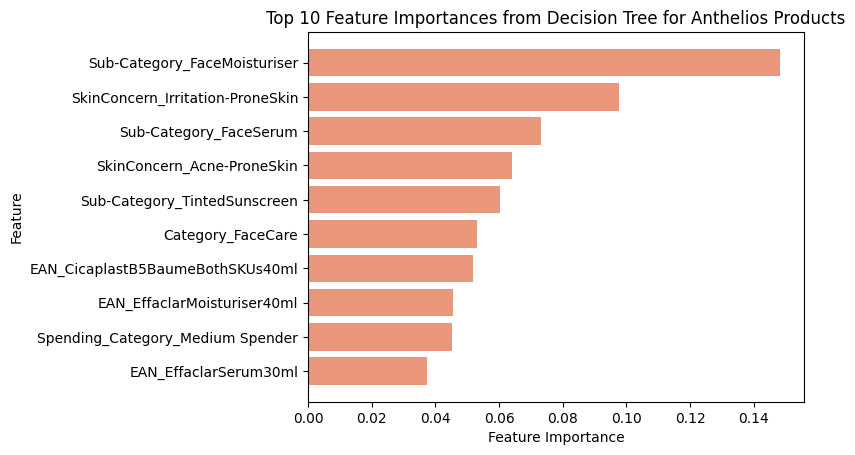

In [83]:
dt_model, score, training_time = pipeline(X, y, parameters, random_state = 0)

results.loc[len(results)] = ['Decision Tree', score, training_time]

In [91]:
dot_data = export_graphviz(dt_model, max_depth=7, impurity=False, feature_names=X.columns.tolist(),
                           class_names=['Purchase', 'Not Purchase'], rounded=True, filled=True)

graph = graphviz.Source(dot_data)
graph.render('DecisionTree')

'DecisionTree.pdf'

## 6.3. Random Forests

In [92]:
def search_param(random_search, X, y):
  print("\033[1mLooking for best parameters...\033[0m\n")
  random_search.fit(X, y)
  print(f"Best parameters: {random_search.best_params_}\n")
  return random_search.best_estimator_

# Define the calculate_metrics function
def calculate_metrics(y_true, y_pred, y_prob):
    f1 = f1_score(y_true, y_pred)
    print(f"F1 Score: {f1:.3f}")
    return f1

# Function to perform cross-validation to see overfitting
def cross_val_rf(model, X_train, y_train, parameters, random_state=0):
    kf = KFold(n_splits=5)
    print("\033[1mRandom Forest Model training...\033[0m\n")

    best_score = -float('inf')
    fold = 1
    for train_index, val_index in kf.split(X_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[val_index]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        model = model.fit(X_train_fold, y_train_fold)

        predictions = model.predict(X_val_fold)
        pred_proba = model.predict_proba(X_val_fold)[:, 1]

        print(f"Result for fold {fold}")
        score = calculate_metrics(y_val_fold, predictions, pred_proba)
        print()

        if score > best_score:
            best_score = score
        fold += 1

    print(f"Best score achieved: {best_score:.3f}")
    print("="*50)

def evaluation_rf(model, X_test, y_test, scaler):
    print("\033[1mModel testing...\033[0m\n")
    predictions = model.predict(X_test)
    pred_proba = model.predict_proba(X_test)[:, 1]
    score = calculate_metrics(y_test, predictions, pred_proba)
    return score

In [93]:
def feature_importance_rf(model, X):
    importances = model.feature_importances_

    # Top 10 important features
    top_k_idx = np.argsort(importances)[-10:]

    # Extract feature names and importance scores
    X_top_k = X.iloc[:, top_k_idx]
    feature_names = X_top_k.columns
    top_k_importances = importances[top_k_idx]

    plt.barh(feature_names, top_k_importances, color = '#7ac5cd')
    plt.xlabel("Feature Importance")
    plt.ylabel("Feature")
    plt.title(f"Top 10 Feature Importances from Random Forest for Anthelios Products")
    plt.show()


def pipeline_rf(X, y, parameters, random_state):
    X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, random_state = 0)

    #look for the best parameters
    random_search = RandomizedSearchCV(
        RandomForestClassifier(criterion='entropy', random_state=random_state),
        parameters, n_iter=5, cv=5, scoring='f1', random_state=random_state
    )
    best_model = search_param(random_search, X_train, y_train)

    cross_val_rf(best_model, X_train, y_train, parameters, random_state)

    start_time = time.time()
    best_model = best_model.fit(X_train, y_train)
    end_time = time.time()
    training_time = end_time - start_time
    print(f"Training Time: {training_time:.2f} seconds")

    #testing the model
    score = evaluation_rf(best_model, X_test, y_test, scaler)

    feature_importance_rf(best_model, X)

    return best_model, score, training_time

Looking for best parameters...

Best parameters: {'min_samples_leaf': 19, 'max_features': 44, 'class_weight': 'balanced'}

Random Forest Model training...

Result for fold 1
F1 Score: 0.474

Result for fold 2
F1 Score: 0.459

Result for fold 3
F1 Score: 0.460

Result for fold 4
F1 Score: 0.460

Result for fold 5
F1 Score: 0.462

Best score achieved: 0.474
Training Time: 2.29 seconds
Model testing...

F1 Score: 0.442


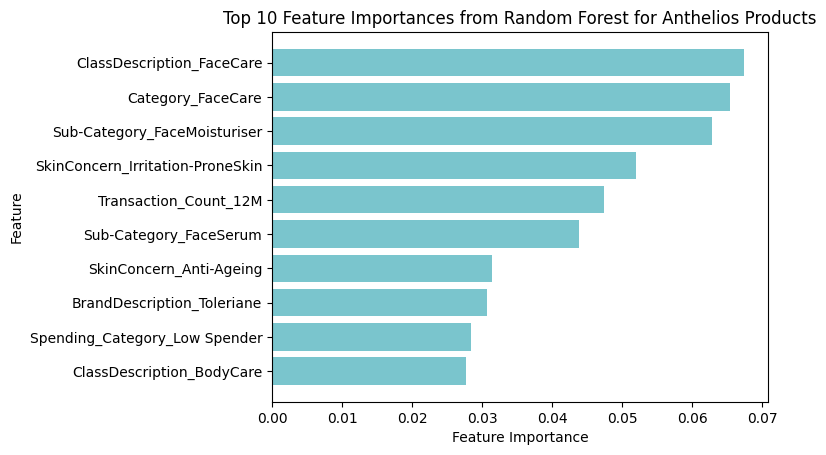

In [94]:
parameters_rf = {
    'min_samples_leaf': np.arange(1, 20),
    'max_features': np.arange(1, len(X.columns)-1),
    'class_weight': ['balanced', 'balanced_subsample']
}

model, score, training_time = pipeline_rf(X, y, parameters_rf, random_state= 0)

results.loc[len(results)] = ['Random Forest', score, training_time]

## 6.4. Gradient Boosting

In [95]:
def calculate_metrics(y_true, y_pred, y_prob):
    f1 = f1_score(y_true, y_pred)
    print(f"F1 Score: {f1:.3f}")
    return f1

def search_param(random_search, X, y):
  print("\033[1mLooking for best parameters...\033[0m\n")
  random_search.fit(X, y)
  print(f"Best parameters: {random_search.best_params_}\n")
  return random_search.best_estimator_

def cross_val_training(model, X_train, y_train, parameters, random_state):
    kf = KFold(n_splits=5)
    print("\033[1mModel training...\033[0m\n")

    best_score = -float('inf')
    fold = 1

    for train_index, val_index in kf.split(X_train):
        X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[val_index]
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

        model = model.fit(X_train_fold, y_train_fold)

        # Make predictions
        predictions = model.predict(X_val_fold)
        pred_proba = model.predict_proba(X_val_fold)[:, 1]

        # Calculate and store metrics
        print(f"Result for fold {fold}")
        score = calculate_metrics(y_val_fold, predictions, pred_proba)
        print()

        if score > best_score:
            best_score = score
        fold += 1

    print(f"Best score achieved: {best_score:.3f}")
    print("="*50)

def evaluation(model, X_test, y_test):
    print("\033[1mModel testing...\033[0m\n")
    predictions = model.predict(X_test)
    pred_proba = model.predict_proba(X_test)[:, 1]
    score = calculate_metrics(y_test, predictions, pred_proba)
    return score

def feature_extract(model, X):
    importances = model.feature_importances_

    top_k_idx = np.argsort(importances)[-10:]

    X_top_k = X.iloc[:, top_k_idx]
    feature_names = X_top_k.columns
    top_k_importances = importances[top_k_idx]

    plt.barh(feature_names, top_k_importances, color = '#e9967a')
    plt.xlabel("Feature Importance")
    plt.ylabel("Feature")
    plt.title(f"Top 10 Feature Importances from Gradient Boosting for Anthelios Products")
    plt.show()

In [96]:
def pipeline(X, y, parameters, random_state):
    X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.8, random_state = 0)

    #look for the best parameters
    random_search = RandomizedSearchCV(
        XGBClassifier(objective='binary:logistic', eval_metric='logloss', random_state=random_state),
        parameters, n_iter=5, cv=3, scoring='f1', random_state=random_state
    )
    best_model = search_param(random_search, X_train, y_train)

    cross_val_training(best_model, X_train, y_train, parameters, random_state)

    start_time = time.time()
    best_model = best_model.fit(X_train, y_train)
    end_time = time.time()
    training_time = end_time - start_time
    print(f"Training Time: {training_time:.2f} seconds")

    #testing the model
    score = evaluation(best_model, X_test, y_test)

    feature_extract(best_model, X)

    return best_model, score, training_time

In [97]:
parameters = {'n_estimators': np.arange(1, 100),
              'learning_rate': np.linspace(0.1, 1, 10),
              'max_depth': np.arange(1, 100),
              'subsample': np.linspace(0.5, 1.0, 6),
              'scale_pos_weight': np.logspace(1, 2.5, 100)}

Looking for best parameters...

Best parameters: {'subsample': 0.5, 'scale_pos_weight': 187.3817422860383, 'n_estimators': 29, 'max_depth': 38, 'learning_rate': 0.1}

Model training...

Result for fold 1
F1 Score: 0.632

Result for fold 2
F1 Score: 0.610

Result for fold 3
F1 Score: 0.604

Result for fold 4
F1 Score: 0.589

Result for fold 5
F1 Score: 0.625

Best score achieved: 0.632
Training Time: 0.37 seconds
Model testing...

F1 Score: 0.630


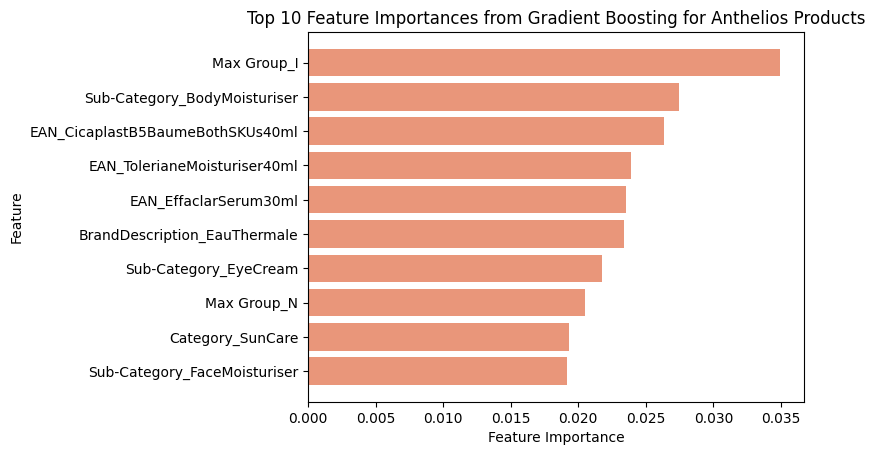

In [98]:
model,score,training_time = pipeline(X, y, parameters, random_state = 0)

results.loc[len(results)] = ['Gradient Boosting (XGBoost)', score, training_time]

# 7. Model Results

In [99]:
results.round(3)

,Method,F1 - Score,Training Time
0,Logistic Regression (Base Model),0.425,0.276
1,Logistic Regression (Log Transformation),0.421,0.305
2,Ridge Regression Model,0.434,33.132
3,Lasso Regression Model,0.422,394.290
4,Decision Tree,0.347,0.030
5,Random Forest,0.442,2.291
6,Gradient Boosting (XGBoost),0.630,0.369
